In [ ]:
%%capture
!pip install sdv


# **Partie 0 : Importation des fichiers et librairies nécessaires**

L'idée d'axer notre projet sur la données synthétiques découle de plusieurs intérêt, d'abord la gestion du risque qui est une composante fondamentale en finance et en assurance. Par la suite en explorant le paradigme de ce domaine, on a cheché sur kaggle les dataset en lien avec ceci.

De plus, il fallait trouver un sujet intéressant, d'un point de vu technique mais aussi dans l'air du temps, ce qui nous permettrait d'avoir un solide bagage technique pour le monde de l'entreprise avec des compétences recherchés. C'est ainsi que l'on s'est dirigé vers les données synthétiques. En plus d'être un projet "exotique", l'idée d'améliorer les performances d'un modèle non pas par la data augmentation mais par la synthétisation à partir données originelles est un chemin qui ne semble pas évident, et pourtant, on verra dans notre projet que cette simple génération à permis d'améliorer grandement les performances d'un Random Tree Classifier selon nos critères.

On a choisi de travailler sur l'aspect gestion des risques dans l'économie et plus précisément sur l'affectation de crédit et l'évaluation du risque de défaut. Ainsi notre choix c'est posé sur le dataset : https://www.kaggle.com/datasets/laotse/credit-risk-dataset. Celui-ci à plusieurs avantages notamment dans notre objectif de génération de données synthétiques. Celui-ci à comporte des données tabulaires avec une bonne cohérence (on verra après), comporte un bon nombre de lignes (32581) et comporte une déséquilibre sur la variable que l'on vise ici, le défaut de paiement. Chose que l'on va essayer de voir en quoi ceci peut-être important pour nos objectifs, qui n'est pas de visé un bon modèle mais de bonnes données. Détecter un défaut de paiement est un enjeu majeur dans l'attribution de crédit et le risque de laisser passer un tel cas doit être détecter au mieux

L'idée est de voir si dans un monde où les LLMs deviennent de plus en plus omni-présent, est-ce que les modèles plus spécialisés restent efficaces

Ainsi, selon notre sommaire :

1.   Partie 0 :  Importation du nécessaire
2.   Partie 1 : Exploration afin de compredre au mieux les données que l'on cherche à générer
3.   Partie 2 : Entrainement et prise en main de la librairie SDV, coeur battant de notre projet
4.   Partie 3 : Entrainement sur des RTC, on évaluera ici la vraie utilité de nos synthèses
5.   Partie 4 : Essai de génération de données via LLM afin de voir si ils sont capables de produire des données tabulaires cohérentes
6.   Partie 5 : Conclusion sur nos travaux et utilité de la synthèse


In [ ]:
import os
import pandas as pd
import math
import matplotlib.pyplot as plt
import seaborn as sns

from sdv.metadata import SingleTableMetadata

from google.colab import userdata

# Remplacer dans Colab, les clefs et identité pour se connecter à Kaggle
os.environ['KAGGLE_USERNAME'] = userdata.get('Kaggle_username')
os.environ['KAGGLE_KEY'] = userdata.get('Kaggle_Key')

!kaggle datasets download -d laotse/credit-risk-dataset
!unzip credit-risk-dataset.zip

df = pd.read_csv('credit_risk_dataset.csv')
print(df.head())

# https://docs.sdv.dev/sdv

Dataset URL: https://www.kaggle.com/datasets/laotse/credit-risk-dataset
License(s): CC0-1.0
credit-risk-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)
Archive:  credit-risk-dataset.zip
replace credit_risk_dataset.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: credit_risk_dataset.csv  
   person_age  person_income person_home_ownership  person_emp_length  \
0          22          59000                  RENT              123.0   
1          21           9600                   OWN                5.0   
2          25           9600              MORTGAGE                1.0   
3          23          65500                  RENT                4.0   
4          24          54400                  RENT                8.0   

  loan_intent loan_grade  loan_amnt  loan_int_rate  loan_status  \
0    PERSONAL          D      35000          16.02            1   
1   EDUCATION          B       1000          11.14            0   
2     MEDICAL  

# **Partie 1 : Data exploration**

Prenons un aperçu rapide des données

In [ ]:
print(df.info())

# Première description des données numériques et analyse des valeurs manquantes
print(df.describe())
print("=====================================")
print(df.isnull().sum())
print("=====================================")

# Affichage de la distribution des valeurs categorique
for col in df.select_dtypes(include=['object']):
    print(f"\nColumn: {col}")
    print(df[col].value_counts())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32581 entries, 0 to 32580
Data columns (total 12 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   person_age                  32581 non-null  int64  
 1   person_income               32581 non-null  int64  
 2   person_home_ownership       32581 non-null  object 
 3   person_emp_length           31686 non-null  float64
 4   loan_intent                 32581 non-null  object 
 5   loan_grade                  32581 non-null  object 
 6   loan_amnt                   32581 non-null  int64  
 7   loan_int_rate               29465 non-null  float64
 8   loan_status                 32581 non-null  int64  
 9   loan_percent_income         32581 non-null  float64
 10  cb_person_default_on_file   32581 non-null  object 
 11  cb_person_cred_hist_length  32581 non-null  int64  
dtypes: float64(3), int64(5), object(4)
memory usage: 3.0+ MB
None
         person_age  perso

On voit notamment le fameux déséquilibre de la variable cible, ce qui en tant normal mène à des modèles qui peuvent avoir de mauvaises prédictions, ainsi que des valeurs manquantes, il sera intéréssant de voir si cela sera défi à relever

In [ ]:
# Analyse complète des variables numériques et catégorielles.

def plot_numerical_eda(df, target_col="cb_person_default_on_file", ncols=3):

    numerical_cols = df.select_dtypes(include=['number']).columns
    categorical_cols = df.select_dtypes(include=['object', 'category']).columns
    num_numerical_cols = len(numerical_cols)
    nrows = math.ceil(num_numerical_cols / ncols)

    # 1. Histogrammes
    plt.figure(figsize=(ncols * 5, nrows * 4))
    plt.suptitle('Histograms of Numerical Features', fontsize=16, y=1.02)
    for i, col in enumerate(numerical_cols):
        ax = plt.subplot(nrows, ncols, i + 1)
        sns.histplot(df[col], kde=True, ax=ax)
        ax.set_title(col)
        ax.set_xlabel('')
        ax.set_ylabel('')
    plt.tight_layout(rect=[0, 0.03, 1, 0.98])
    plt.show()

    # 2. Boxplots
    plt.figure(figsize=(ncols * 4, nrows * 5))
    plt.suptitle('Boxplots of Numerical Features', fontsize=16, y=1.02)
    for i, col in enumerate(numerical_cols):
        ax = plt.subplot(nrows, ncols, i + 1)
        sns.boxplot(y=df[col], ax=ax)
        ax.set_title(col)
        ax.set_ylabel('')
    plt.tight_layout(rect=[0, 0.03, 1, 0.98])
    plt.show()

    # 3. Matrice de corrélation
    plt.figure(figsize=(10, 8))
    sns.heatmap(df[numerical_cols].corr(), annot=True, cmap='coolwarm', fmt=".2f")
    plt.title('Correlation Matrix of Numerical Features')
    plt.show()

    # 4. Pairplot sur toutes les colonnes numériques
    print("\nGenerating Pairplot on all numerical features (this might take some time)...")
    if target_col and target_col in df.columns:
        sns.pairplot(df[numerical_cols.tolist() + [target_col]], hue=target_col, diag_kind='kde')
    else:
        sns.pairplot(df[numerical_cols], diag_kind='kde')
    plt.suptitle('Pairplot of Numerical Features', y=1.02, fontsize=16)
    plt.show()

    # 5. Relations cat. vs. numériques
    for cat_col in categorical_cols:
        if cat_col == target_col:
            continue

        relevant_num_cols = [col for col in numerical_cols if col != target_col]
        if not relevant_num_cols:
            continue

        num_plots = len(relevant_num_cols)
        ncols_cat = 3
        nrows_cat = math.ceil(num_plots / ncols_cat)

        plt.figure(figsize=(ncols_cat * 5, nrows_cat * 4))
        plt.suptitle(f'Relationship of {cat_col} with Numerical Features', fontsize=16, y=1.02)

        for i, num_col in enumerate(relevant_num_cols):
            ax = plt.subplot(nrows_cat, ncols_cat, i + 1)
            sns.boxplot(x=df[cat_col], y=df[num_col], ax=ax)
            ax.set_title(f'{num_col} by {cat_col}')
            ax.set_xlabel('')
            ax.set_ylabel('')
            plt.xticks(rotation=45, ha='right')

        plt.tight_layout(rect=[0, 0.03, 1, 0.98])
        plt.show()

    # 6. Distribution de la variable cible
    if target_col and target_col in df.columns:
        plt.figure(figsize=(6, 5))
        sns.countplot(x=df[target_col])
        plt.title(f'Distribution of Target Variable ({target_col})')
        plt.xlabel(target_col)
        plt.ylabel('Count')
        plt.show()

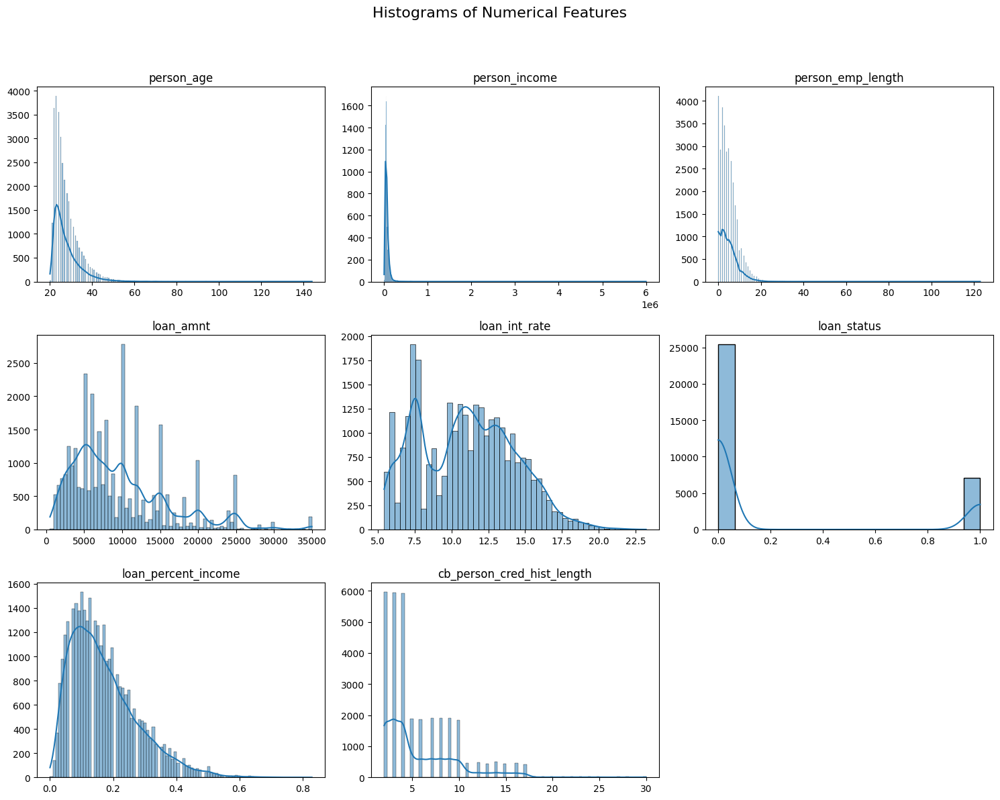

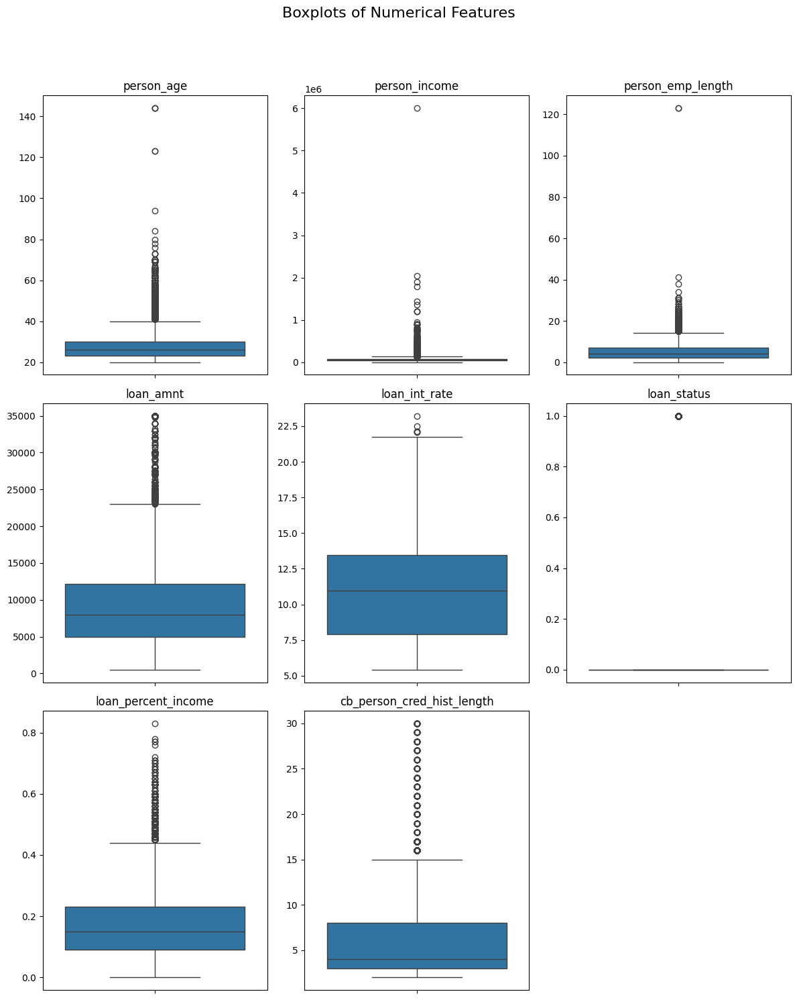

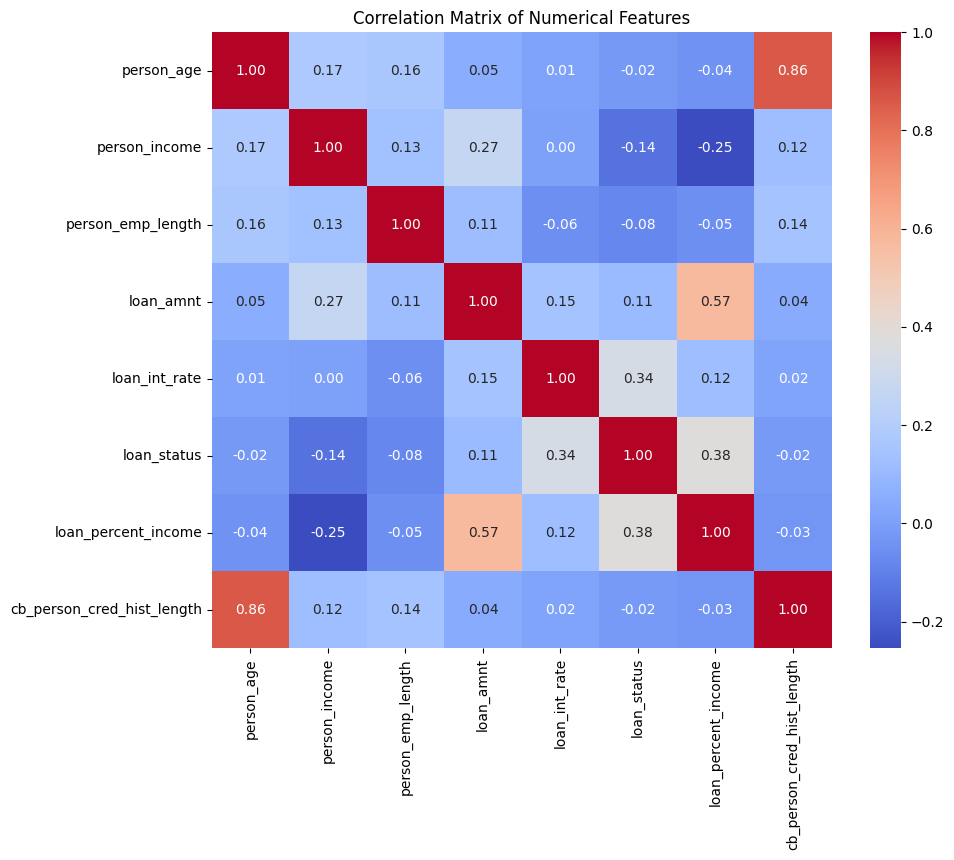


Generating Pairplot on all numerical features (this might take some time)...


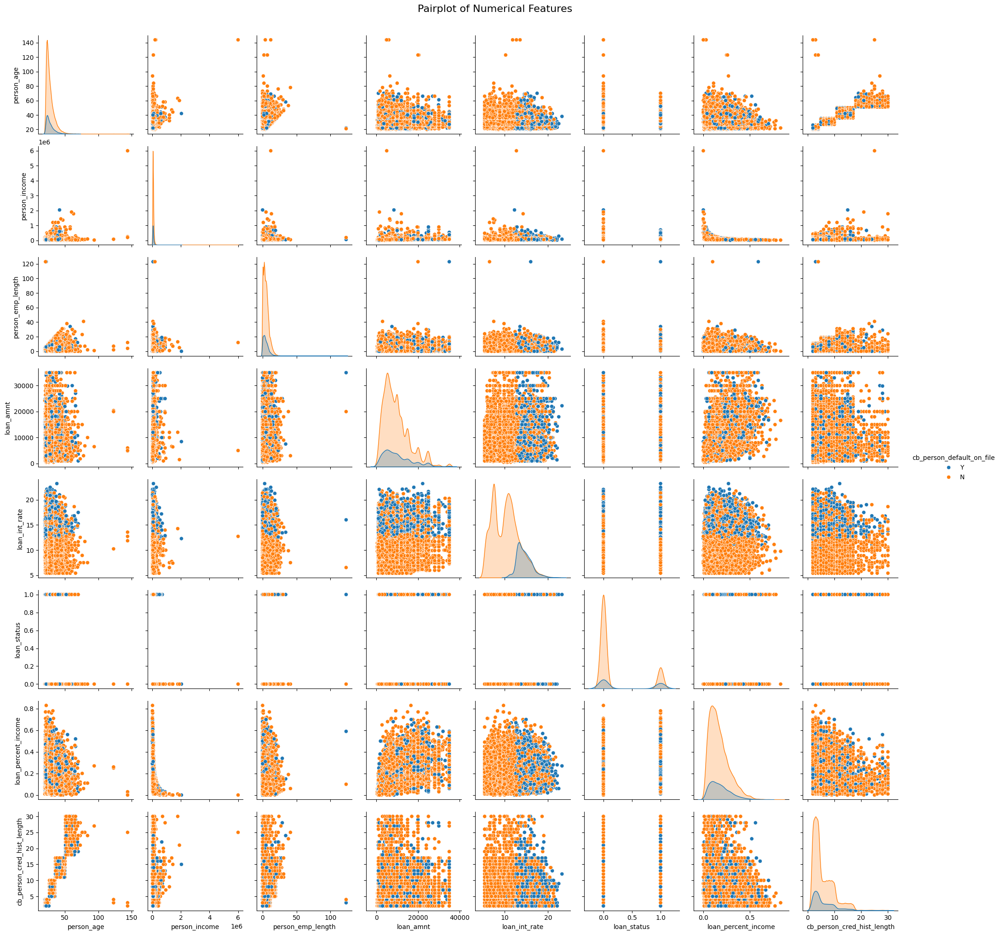

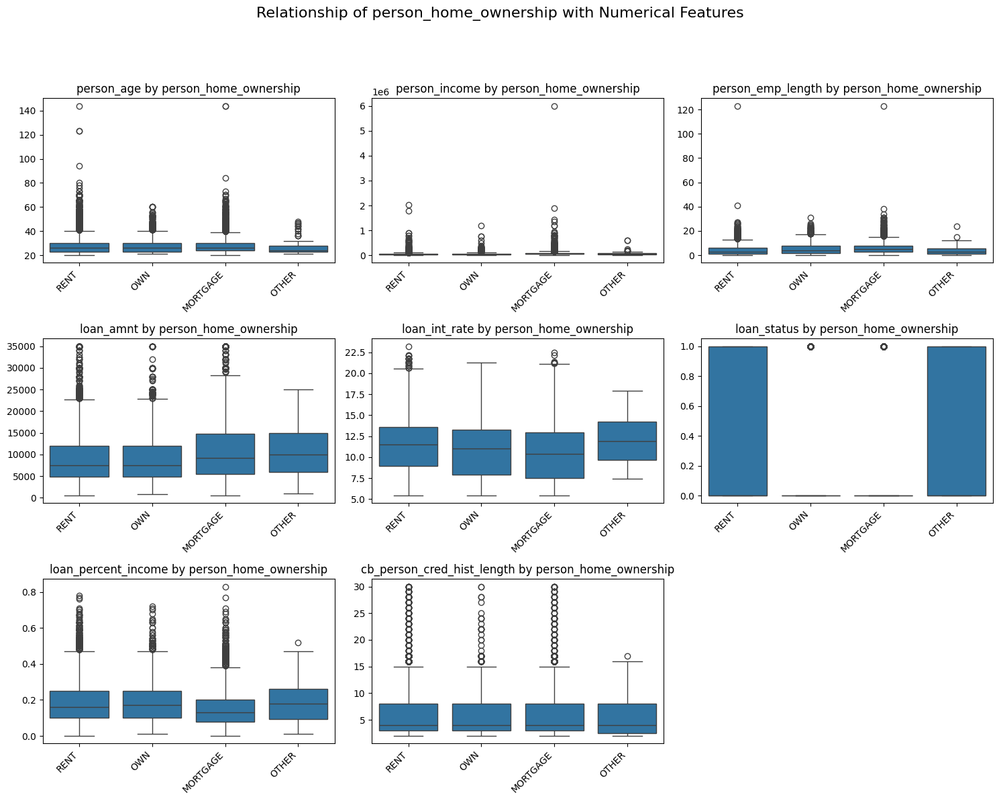

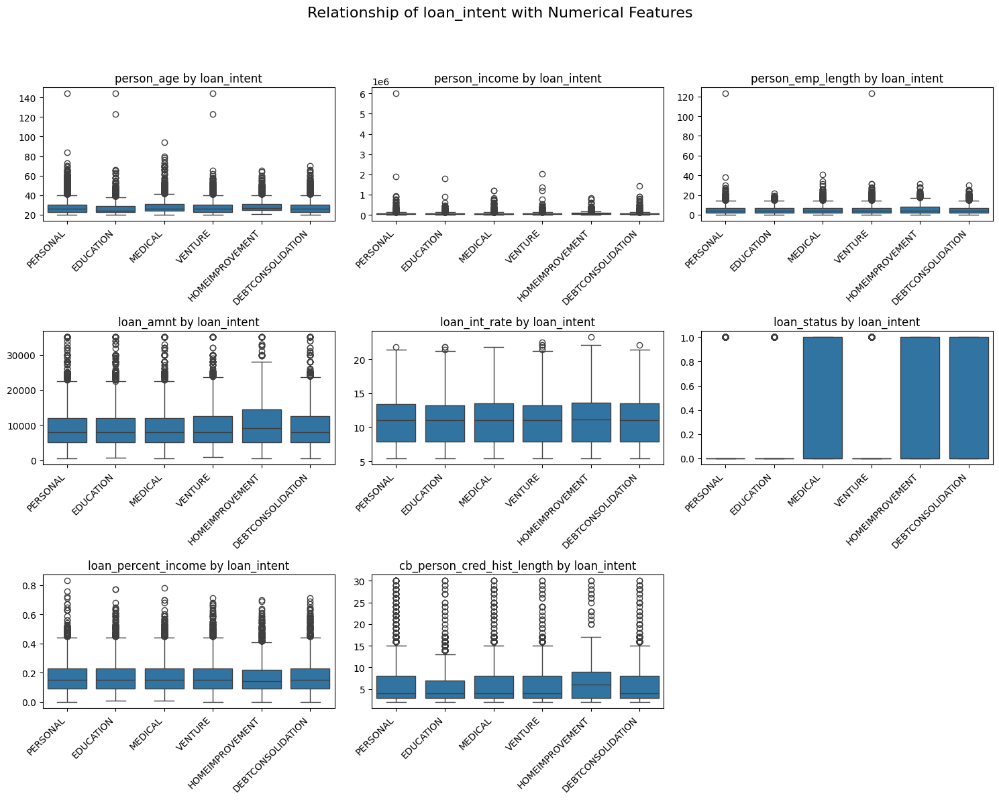

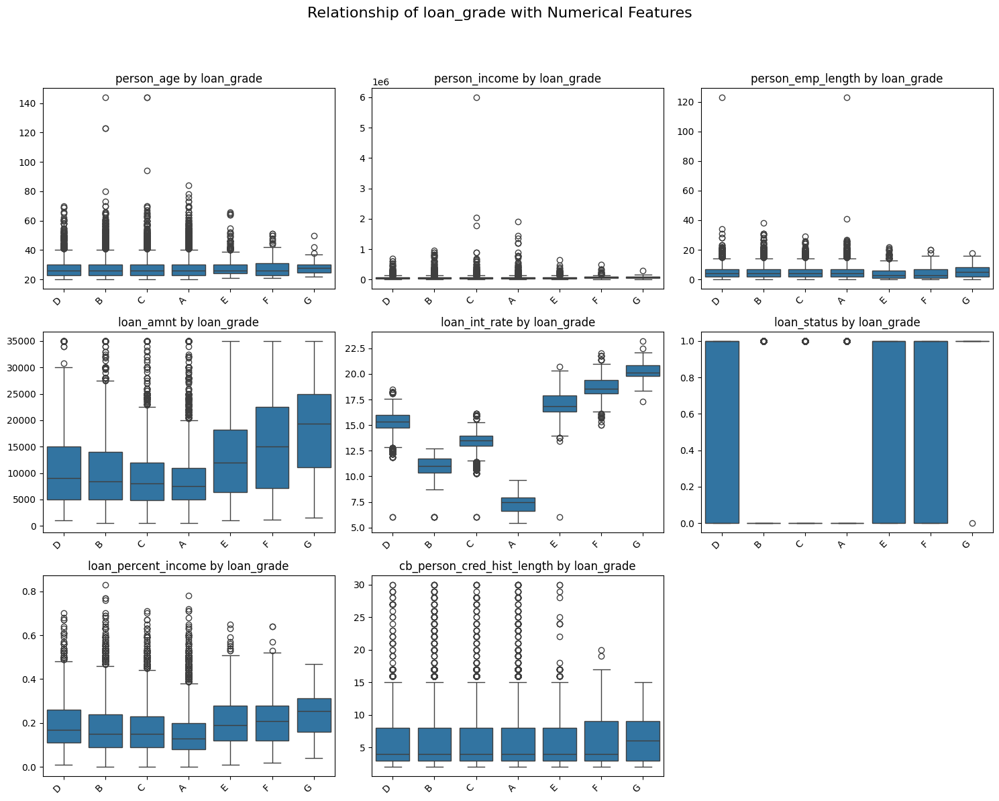

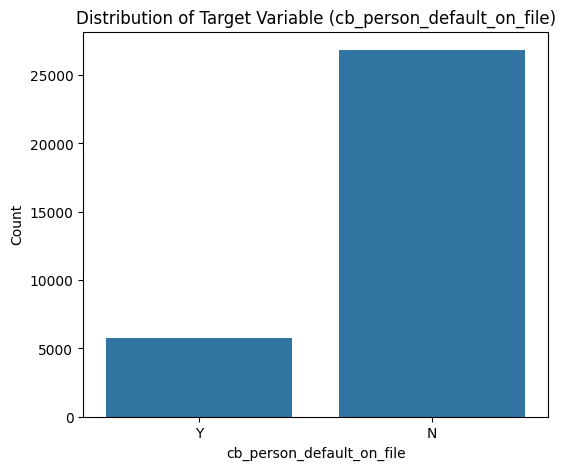

In [ ]:
plot_numerical_eda(df, ncols=3)

On peut commencer à voir certaines tendances, cependant les outliers camoufle certains graphiques, enlevons les pour avoir un meilleur aperçu de l'ensemble

In [ ]:
def remove_outliers_iqr(df):
    columns = df.select_dtypes(include=['number']).columns
    filtered_df = df.copy()
    for col in columns:
        if pd.api.types.is_numeric_dtype(filtered_df[col]):
            Q1 = filtered_df[col].quantile(0.25)
            Q3 = filtered_df[col].quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.75 * IQR
            upper_bound = Q3 + 1.75 * IQR
            filtered_df = filtered_df[(filtered_df[col] >= lower_bound) & (filtered_df[col] <= upper_bound)]
    return filtered_df

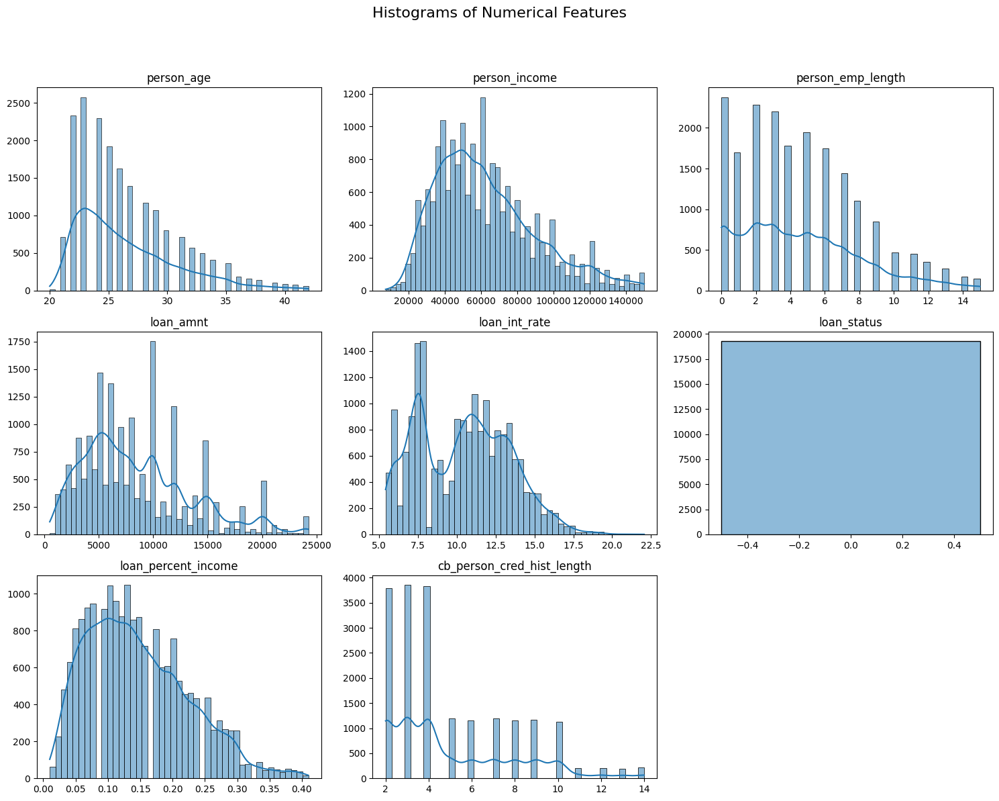

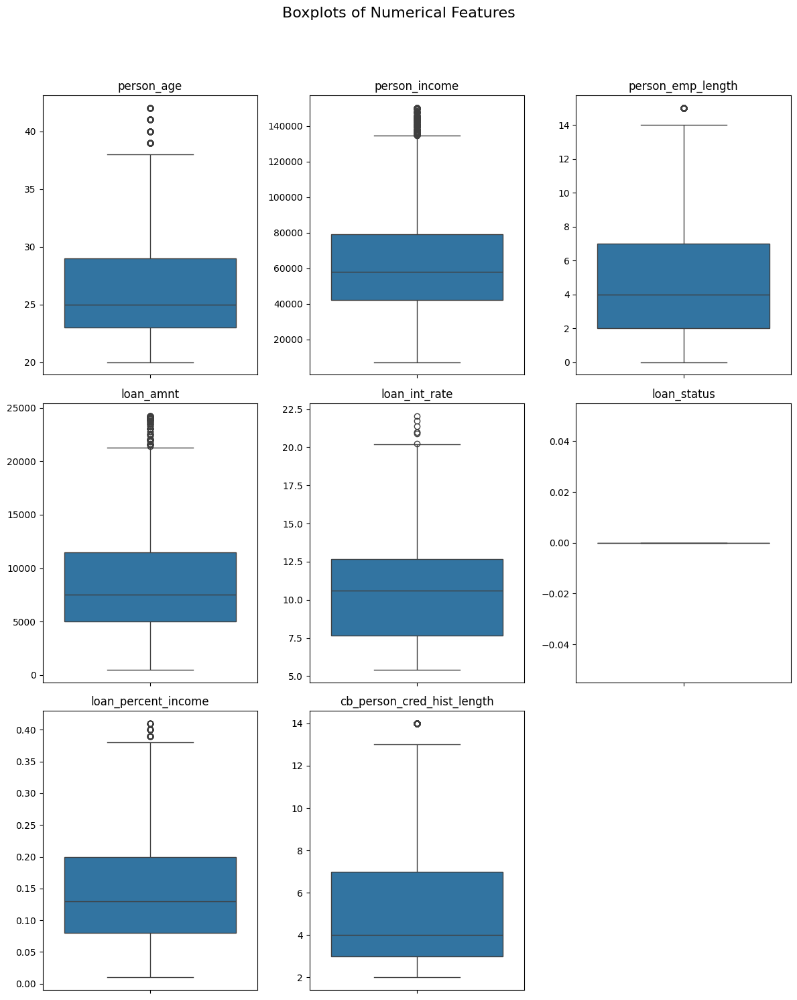

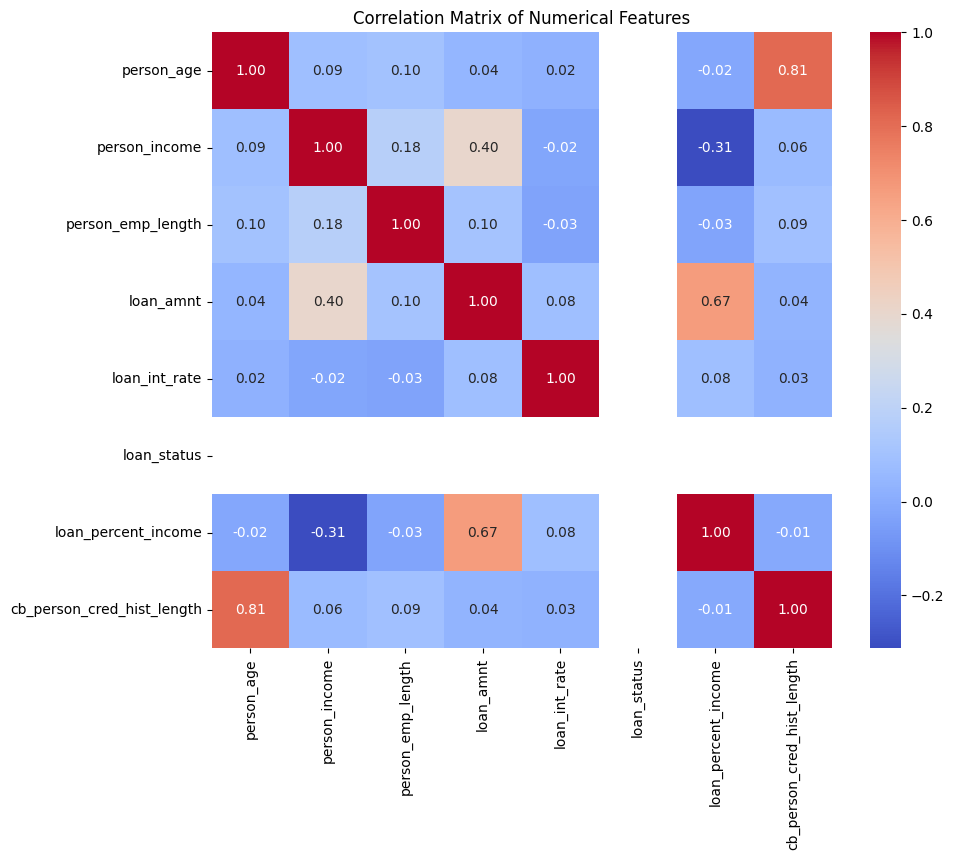


Generating Pairplot on all numerical features (this might take some time)...


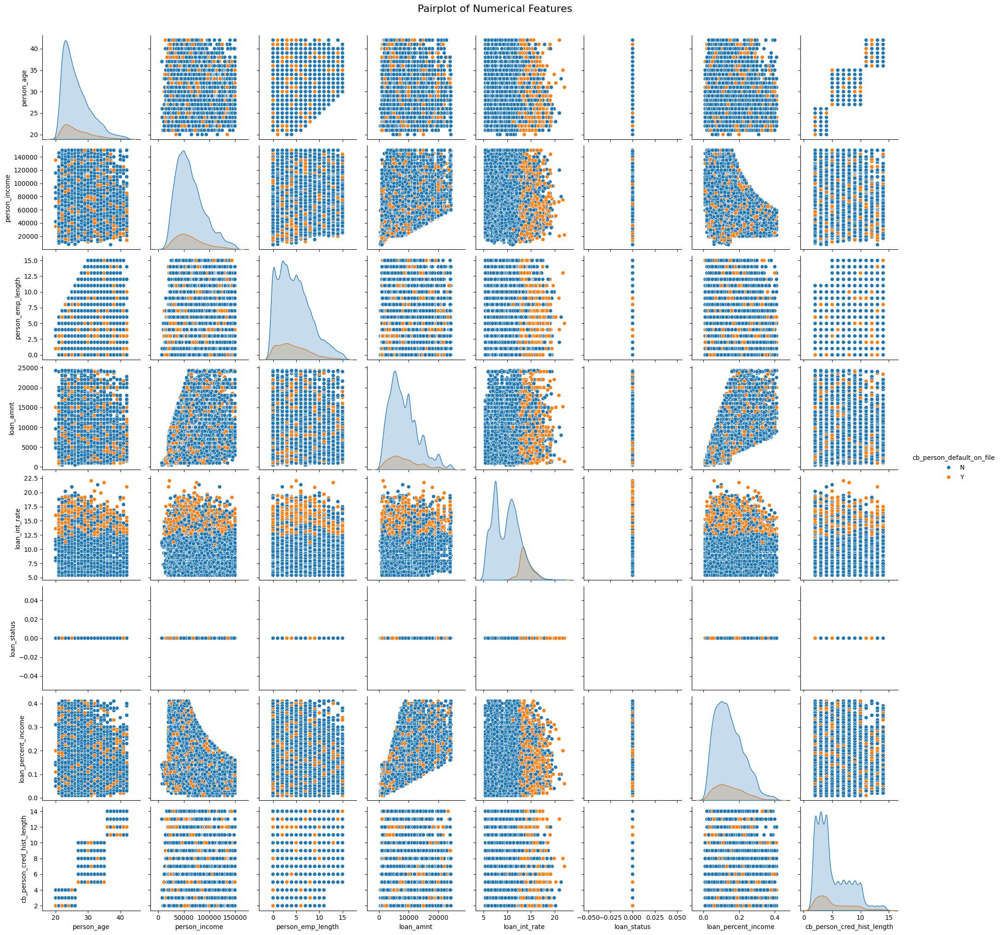

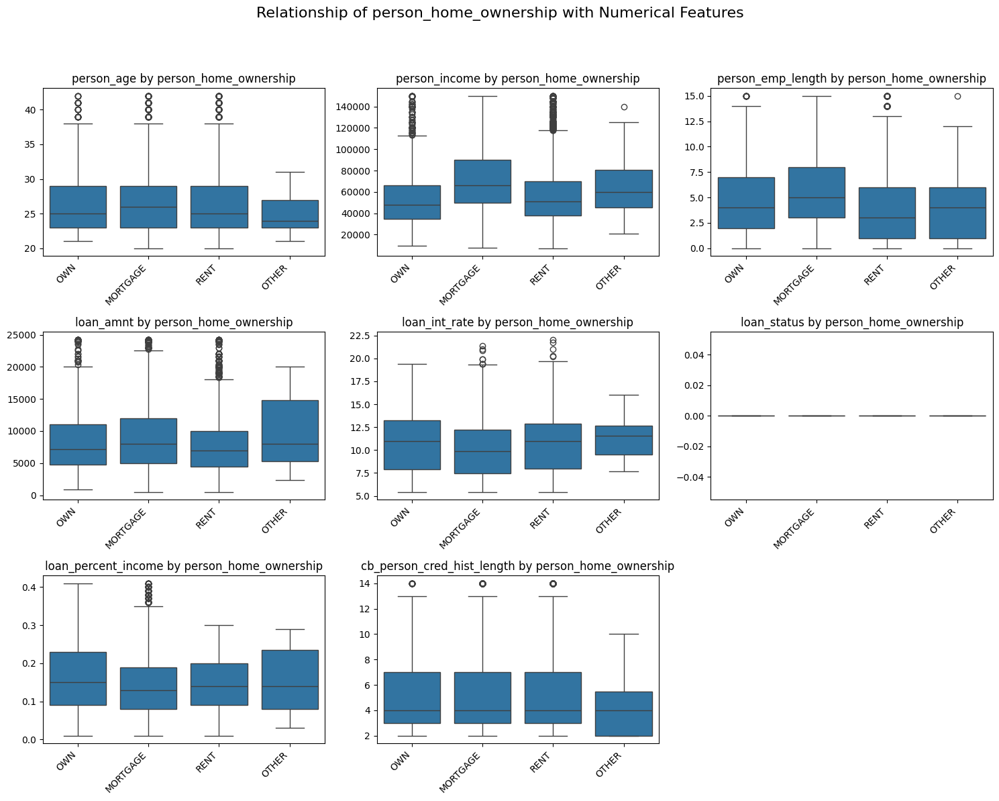

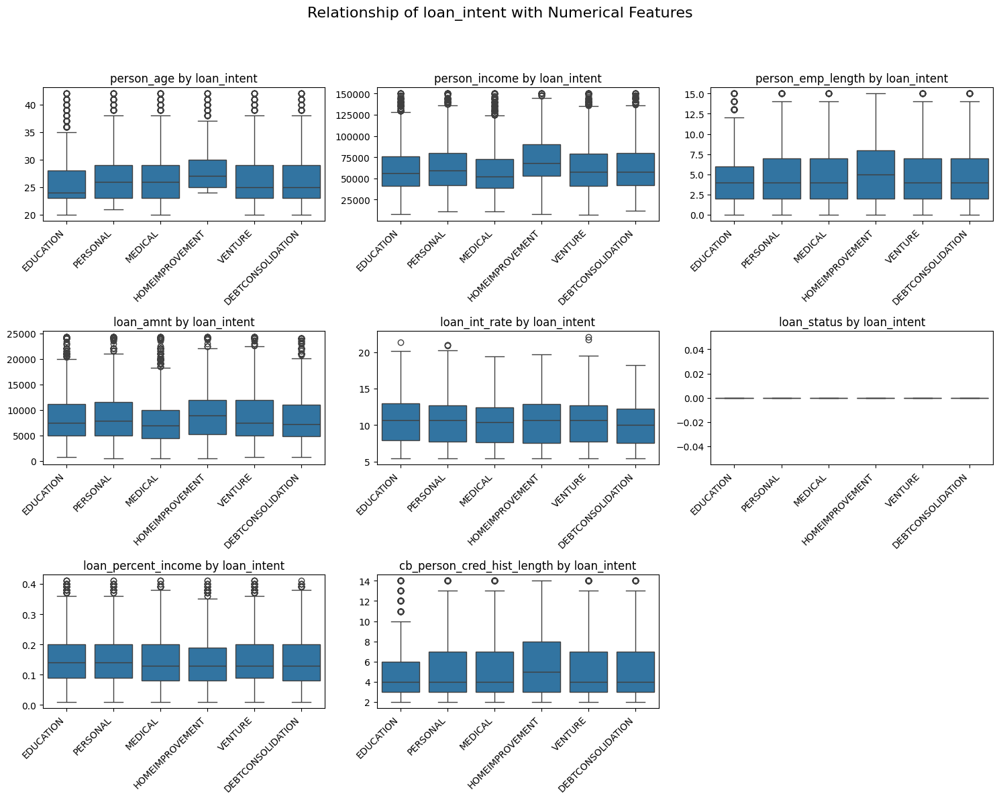

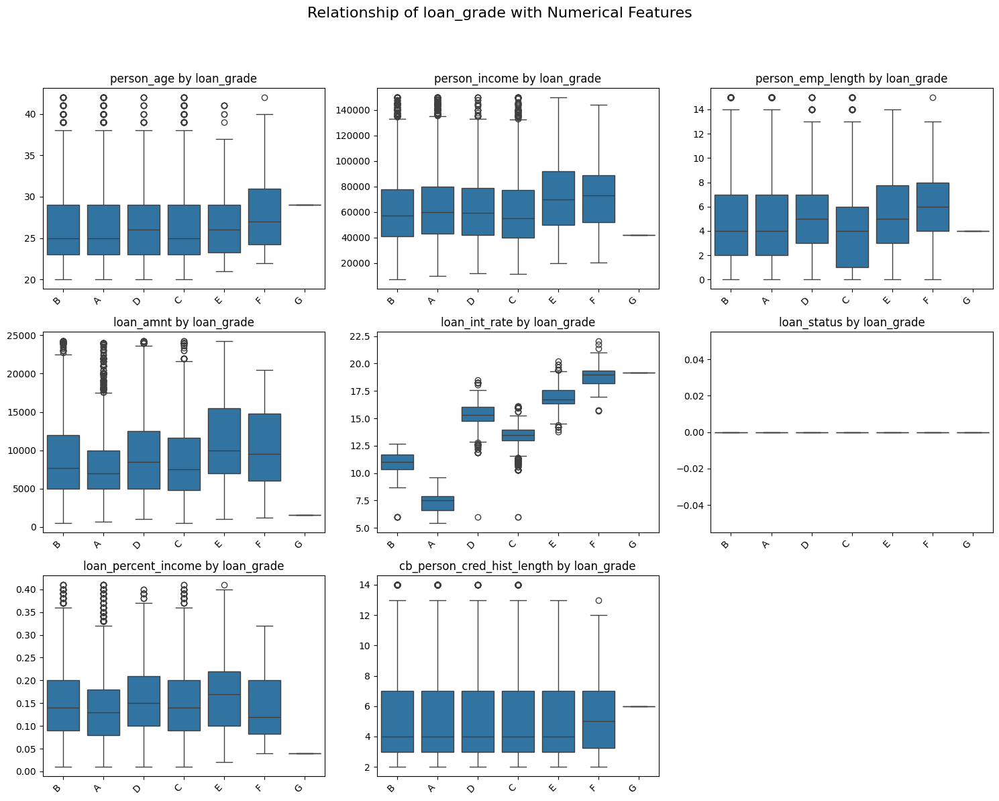

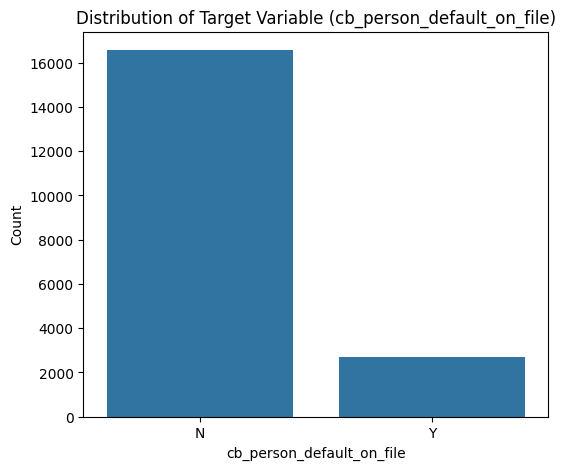

In [ ]:
df_filtered = remove_outliers_iqr(df)
plot_numerical_eda(df_filtered, ncols=3)

On peut avoir ainsi un aperçu de la distribution des données, le but ici n'est aps tant d'analyser les liens entres les variables mais plutôt de voir si ils sont conservés après la génération synthétique.

 Dans les statistiques sautant aux yeux, on peut voir un solide lien entre l'âge d'uen personne et son historique de crédit (logique car plus on est agé plus on peut avoir d'historique). Plus quelqu'un a de haut revenu plus il peut faire un emprunt important et moisn c'est une partie important de son revenu. Ou alors que plus un emprunt est élevé et plus il fait partie importante dans du revenu d'une personne

Pour ce qui est du graphique de relation il est difficile de voir une tendance sauf pour ce qui est du taux d'intérêt, en effet, on voit que les défauts de paiements n'arrive quasi que lorsque un taux d'intérêt est élevé, à part sur les graphiques classiques que l'on pourra mieux évaluer avec un outil dans SDV, le reste ne semble pas sortir de tendances clairs

Le reste des graphiques bien que ne sortant pas de tendance, il reste intéressant à garder car il faut voir si cette répartition est conservé dans dans la synthétisation

# **Partie 2 : Création des modèles de génération synthétique**



Maintenant qu'on a meilleur aperçu des données, on peut se pencher sur la solution pour en synthétiser de nouvelles. On utilisera principalement SDV et ses différentes solutions pour générer nos données et les évaluer

Cette suite de bibliothèque fourni plusieurs modèles ainsi que de manières de les évaluer. Elle est facile à prendre en main et la documentation est très fourni. Un lien menant à la documentation est en bibliographie

Shape of X_train: (26064, 12)
Shape of X_test: (6517, 12)


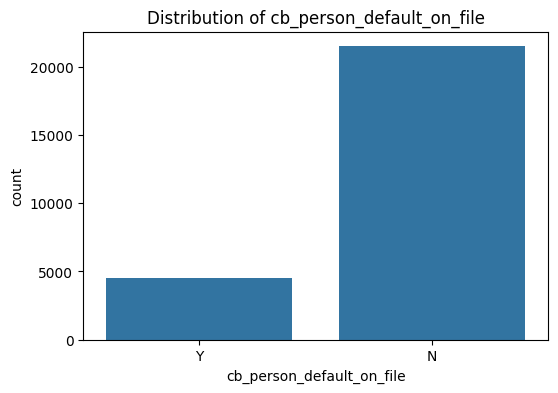


Distribution of cb_person_default_on_file:
cb_person_default_on_file
N    21514
Y     4550
Name: count, dtype: int64


In [ ]:
# Séparation des données train/test pour valider la pertinence des données synthétiques
from sklearn.model_selection import train_test_split

df, df_test = train_test_split(df, test_size=0.2, random_state=42)

print("Shape of X_train:", df.shape)
print("Shape of X_test:", df_test.shape)

# On affiche la répartition de la variable cible sur notre jeu de données de train

plt.figure(figsize=(6, 4))
sns.countplot(x='cb_person_default_on_file', data=df)
plt.title('Distribution of cb_person_default_on_file')
plt.show()

print("\nDistribution of cb_person_default_on_file:")
print(df['cb_person_default_on_file'].value_counts())

On voit clairement un déséquilibre entre les défauts de paiements ou non, l'idée que l'on développe ici sera dans un premier temps de vérifier la validité des données synthétiques même déséquilibré, dans la fin de ce projet on se propose d'essayer de rééquilibrer les deux pour voir si la performance d'un modèle de prédiction s'en voit améliorer

In [ ]:
# Création des metadatas pour la création de données via SDV
metadata = SingleTableMetadata()
metadata.detect_from_dataframe(df)
print(metadata.to_dict())


{'METADATA_SPEC_VERSION': 'SINGLE_TABLE_V1', 'columns': {'person_age': {'sdtype': 'numerical'}, 'person_income': {'sdtype': 'numerical'}, 'person_home_ownership': {'sdtype': 'categorical'}, 'person_emp_length': {'sdtype': 'numerical'}, 'loan_intent': {'sdtype': 'categorical'}, 'loan_grade': {'sdtype': 'categorical'}, 'loan_amnt': {'sdtype': 'numerical'}, 'loan_int_rate': {'sdtype': 'numerical'}, 'loan_status': {'sdtype': 'categorical'}, 'loan_percent_income': {'sdtype': 'numerical'}, 'cb_person_default_on_file': {'sdtype': 'categorical'}, 'cb_person_cred_hist_length': {'sdtype': 'numerical'}}}


In [ ]:
# Création des différents modèles de synthétisations et entrainements

from sdv.single_table import CTGANSynthesizer

synthesizer_GAN = CTGANSynthesizer(metadata, epochs=30, verbose=True)
synthesizer_GAN.fit(df)


from sdv.single_table import GaussianCopulaSynthesizer

synthesizer_GCS = GaussianCopulaSynthesizer(metadata)
synthesizer_GCS.fit(df)


from sdv.single_table import TVAESynthesizer

synthesizer_TVAES = TVAESynthesizer(metadata, epochs=30, verbose=True)
synthesizer_TVAES.fit(df)


#Encore au stade expérimental
from sdv.single_table import CopulaGANSynthesizer

synthesizer_EXP = CopulaGANSynthesizer(metadata, epochs=30, verbose=True)
synthesizer_EXP.fit(df)

/usr/local/lib/python3.11/dist-packages/sdv/single_table/base.py:145: FutureWarning: The 'SingleTableMetadata' is deprecated. Please use the new 'Metadata' class for synthesizers.
  warnings.warn(DEPRECATION_MSG, FutureWarning)
/usr/local/lib/python3.11/dist-packages/sdv/single_table/base.py:123: UserWarning: We strongly recommend saving the metadata using 'save_to_json' for replicability in future SDV versions.
  warnings.warn(
Gen. (-1.54) | Discrim. (0.15): 100%|██████████| 30/30 [02:15<00:00,  4.52s/it]
/usr/local/lib/python3.11/dist-packages/sdv/single_table/base.py:145: FutureWarning: The 'SingleTableMetadata' is deprecated. Please use the new 'Metadata' class for synthesizers.
  warnings.warn(DEPRECATION_MSG, FutureWarning)
/usr/local/lib/python3.11/dist-packages/sdv/single_table/base.py:145: FutureWarning: The 'SingleTableMetadata' is deprecated. Please use the new 'Metadata' class for synthesizers.
  warnings.warn(DEPRECATION_MSG, FutureWarning)
Loss: 6.134: 100%|██████████| 3

In [ ]:
# Phase de synthétisation des données via différentes solutions


#GAN
synthetic_data_GAN = synthesizer_GAN.sample(num_rows=15_000)
print(synthetic_data_GAN.head())

synthetic_data_GAN.to_csv('synthetic_data_GAN.csv', index=False)

#GCS
synthetic_data_GCS = synthesizer_GCS.sample(num_rows=15_000)
print(synthetic_data_GCS.head())

synthetic_data_GCS.to_csv('synthetic_data.csv_GCS', index=False)

#TVAES
synthetic_data_TVAES = synthesizer_TVAES.sample(num_rows=15_000)
print(synthetic_data_TVAES.head())

synthetic_data_TVAES.to_csv('synthetic_data.csv_TVAES', index=False)

#EXP
synthetic_data_EXP = synthesizer_EXP.sample(num_rows=15_000)
print(synthetic_data_EXP.head())

synthetic_data_EXP.to_csv('synthetic_data.csv_EXP', index=False)

   person_age  person_income person_home_ownership  person_emp_length  \
0          23          90766              MORTGAGE                8.0   
1          30          38614              MORTGAGE                6.0   
2          28          71210                   OWN                5.0   
3          24          49182                  RENT               13.0   
4          25           7694                  RENT               12.0   

         loan_intent loan_grade  loan_amnt  loan_int_rate  loan_status  \
0           PERSONAL          A      11993            NaN            0   
1  DEBTCONSOLIDATION          F      11842           5.86            0   
2          EDUCATION          B       9425          13.47            0   
3  DEBTCONSOLIDATION          B      10869          13.06            1   
4            MEDICAL          E        858          11.76            1   

   loan_percent_income cb_person_default_on_file  cb_person_cred_hist_length  
0                 0.20               

===================================================================================================================================================================================================================================================================================================================================================

On a essayé plusieurs fois de faire une PCA amis aucun résultat probant n'en est ressorti, même en ciblant les variables, même avec une UMAP sur ploty

===================================================================================================================================================================================================================================================================================================================================================

In [ ]:
# Génération avec condition, sera utile pour la partie arbre rééquilibrée, permet d'imposer des conditions sur les valeurs créés
# comme par exemple la variable cible, l'âge, ect

import os
from sdv.sampling import Condition

output_file_path = 'synthetic_simulated_scenario_conditon.csv'
if os.path.exists(output_file_path):
    os.remove(output_file_path)
    print(f"Removed existing file: {output_file_path}")


Defaut_de_paiement = Condition(
    num_rows=250,
    column_values={'cb_person_default_on_file': 'Y'}
)

synthetic_data_condition = synthesizer_GCS.sample_from_conditions(
    conditions=[Defaut_de_paiement],
    output_file_path=output_file_path
)
print(synthetic_data_condition.head())

Removed existing file: synthetic_simulated_scenario_conditon.csv


Sampling conditions: 100%|██████████| 250/250 [00:00<00:00, 2483.42it/s]

   person_age  person_income person_home_ownership  person_emp_length  \
0          30          96274                  RENT                0.0   
1          34          42436                  RENT               13.0   
2          23          76865                  RENT                1.0   
3          22          61141                  RENT                0.0   
4          22          87449                  RENT                3.0   

       loan_intent loan_grade  loan_amnt  loan_int_rate  loan_status  \
0  HOMEIMPROVEMENT          E       9501          10.11            0   
1        EDUCATION          D       6786           9.77            1   
2         PERSONAL          A      11407          15.99            1   
3  HOMEIMPROVEMENT          C       9866          10.12            1   
4  HOMEIMPROVEMENT          B       6851          14.35            1   

   loan_percent_income cb_person_default_on_file  cb_person_cred_hist_length  
0                 0.12                         Y 

In [ ]:
# On affiche maintenant les différents graphiques permettant la comparaisons des données réelles et des données fictives via les fonctions de SDV
# Ceci permet de voir si nos données sont en accord avec la réalité ou pas de manière rapide et de les comparer en temps réel

from sdv.evaluation.single_table import run_diagnostic, evaluate_quality
from sdv.evaluation.single_table import get_column_plot
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import math

def plot_synthetic_vs_real_interactive(real_df, synthetic_df, metadata, cols_per_row=2):

    diagnostic = run_diagnostic(real_df, synthetic_df, metadata)
    quality_report = evaluate_quality(real_df, synthetic_df, metadata)

    columns = list(metadata.columns.keys())

    n_cols = cols_per_row
    n_rows = math.ceil(len(columns) / n_cols)

    # Crée la figure subplot
    fig = make_subplots(rows=n_rows, cols=n_cols, subplot_titles=columns)

    for idx, column_name in enumerate(columns):
        print(f"Generating plot for column: {column_name}")
        try:
            plotly_fig = get_column_plot(
                real_data=real_df,
                synthetic_data=synthetic_df,
                metadata=metadata,
                column_name=column_name
            )

            # Ajouter les traces au bon subplot
            row = idx // n_cols + 1
            col = idx % n_cols + 1
            for trace in plotly_fig.data:
                fig.add_trace(trace, row=row, col=col)

        except Exception as e:
            print(f"Could not generate plot for {column_name}: {e}")

    fig.update_layout(height=300*n_rows, width=450*n_cols, showlegend=False)
    fig.show()

In [ ]:
# Appel de la fonction pour les différents jeux de données

plot_synthetic_vs_real_interactive(df_filtered, synthetic_data_GAN, metadata, cols_per_row=3)
plot_synthetic_vs_real_interactive(df_filtered, synthetic_data_GCS, metadata, cols_per_row=3)
plot_synthetic_vs_real_interactive(df_filtered, synthetic_data_TVAES, metadata, cols_per_row=3)
plot_synthetic_vs_real_interactive(df_filtered, synthetic_data_EXP, metadata, cols_per_row=3)

Generating report ...

(1/2) Evaluating Data Validity: |██████████| 12/12 [00:00<00:00, 351.84it/s]|
Data Validity Score: 94.2%

(2/2) Evaluating Data Structure: |██████████| 1/1 [00:00<00:00, 186.77it/s]|
Data Structure Score: 100.0%

Overall Score (Average): 97.1%

Generating report ...

(1/2) Evaluating Column Shapes: |██████████| 12/12 [00:00<00:00, 95.35it/s]|
Column Shapes Score: 85.17%

(2/2) Evaluating Column Pair Trends: |██████████| 66/66 [00:00<00:00, 91.29it/s]|
Column Pair Trends Score: 73.2%

Overall Score (Average): 79.18%

Generating plot for column: person_age
Generating plot for column: person_income
Generating plot for column: person_home_ownership
Generating plot for column: person_emp_length
Generating plot for column: loan_intent
Generating plot for column: loan_grade
Generating plot for column: loan_amnt
Generating plot for column: loan_int_rate
Generating plot for column: loan_status
Generating plot for column: loan_percent_income
Generating plot for column: cb_

Generating report ...

(1/2) Evaluating Data Validity: |██████████| 12/12 [00:00<00:00, 225.85it/s]|
Data Validity Score: 94.49%

(2/2) Evaluating Data Structure: |██████████| 1/1 [00:00<00:00, 265.90it/s]|
Data Structure Score: 100.0%

Overall Score (Average): 97.25%

Generating report ...

(1/2) Evaluating Column Shapes: |██████████| 12/12 [00:00<00:00, 57.56it/s]|
Column Shapes Score: 89.02%

(2/2) Evaluating Column Pair Trends: |██████████| 66/66 [00:00<00:00, 73.75it/s]|
Column Pair Trends Score: 78.05%

Overall Score (Average): 83.54%

Generating plot for column: person_age
Generating plot for column: person_income
Generating plot for column: person_home_ownership
Generating plot for column: person_emp_length
Generating plot for column: loan_intent
Generating plot for column: loan_grade
Generating plot for column: loan_amnt
Generating plot for column: loan_int_rate
Generating plot for column: loan_status
Generating plot for column: loan_percent_income
Generating plot for column: 

Generating report ...

(1/2) Evaluating Data Validity: |██████████| 12/12 [00:00<00:00, 224.01it/s]|
Data Validity Score: 96.43%

(2/2) Evaluating Data Structure: |██████████| 1/1 [00:00<00:00, 313.08it/s]|
Data Structure Score: 100.0%

Overall Score (Average): 98.22%

Generating report ...

(1/2) Evaluating Column Shapes: |██████████| 12/12 [00:00<00:00, 69.53it/s]|
Column Shapes Score: 85.49%

(2/2) Evaluating Column Pair Trends: |██████████| 66/66 [00:01<00:00, 63.45it/s]|
Column Pair Trends Score: 75.1%

Overall Score (Average): 80.3%

Generating plot for column: person_age
Generating plot for column: person_income
Generating plot for column: person_home_ownership
Generating plot for column: person_emp_length
Generating plot for column: loan_intent
Generating plot for column: loan_grade
Generating plot for column: loan_amnt
Generating plot for column: loan_int_rate
Generating plot for column: loan_status
Generating plot for column: loan_percent_income
Generating plot for column: cb

Generating report ...

(1/2) Evaluating Data Validity: |██████████| 12/12 [00:00<00:00, 201.88it/s]|
Data Validity Score: 94.1%

(2/2) Evaluating Data Structure: |██████████| 1/1 [00:00<00:00, 213.13it/s]|
Data Structure Score: 100.0%

Overall Score (Average): 97.05%

Generating report ...

(1/2) Evaluating Column Shapes: |██████████| 12/12 [00:00<00:00, 64.80it/s]|
Column Shapes Score: 84.64%

(2/2) Evaluating Column Pair Trends: |██████████| 66/66 [00:01<00:00, 64.87it/s]|
Column Pair Trends Score: 71.8%

Overall Score (Average): 78.22%

Generating plot for column: person_age
Generating plot for column: person_income
Generating plot for column: person_home_ownership
Generating plot for column: person_emp_length
Generating plot for column: loan_intent
Generating plot for column: loan_grade
Generating plot for column: loan_amnt
Generating plot for column: loan_int_rate
Generating plot for column: loan_status
Generating plot for column: loan_percent_income
Generating plot for column: cb

La mesure de run_diagnostic permet de vérifier la validité des données et leurs bonnes prises en comptes, un résultat très élevé est nécessaire, sinon c'est que la synthétisation sera de mauvaise qualité

La mesure de evaluate_quality permet d'avoir une valeur numérique rapide qui permet d'évaluer si la synthétisation est correct ou non, ici GCS a eu un résultat de 83.54%

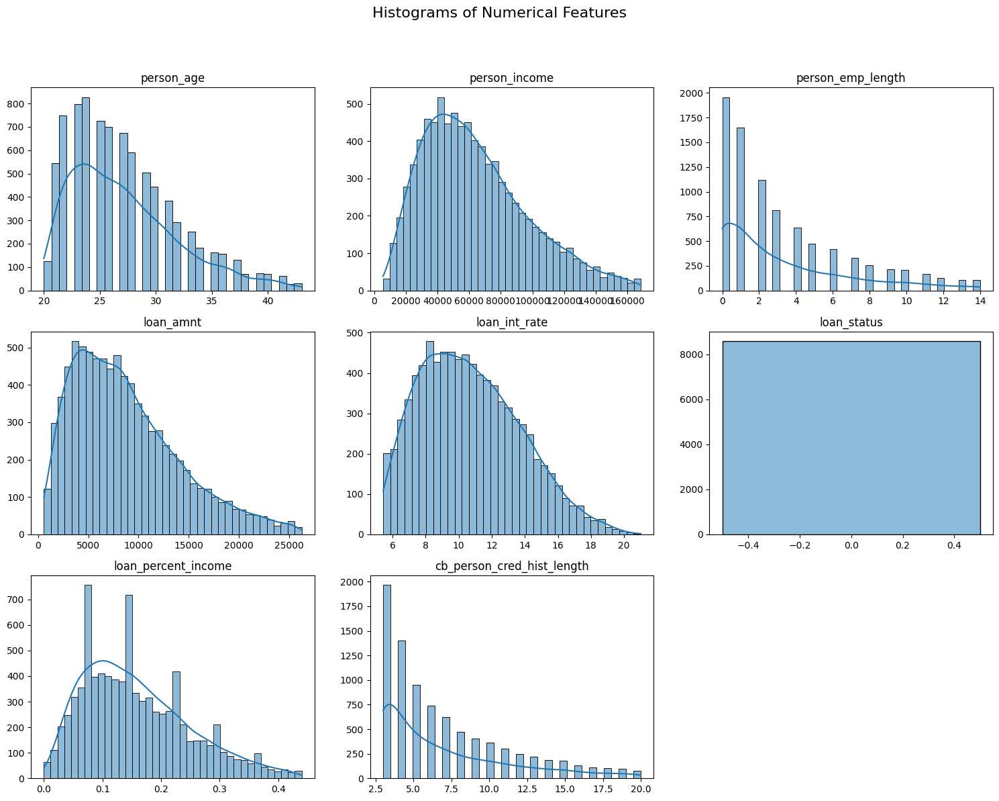

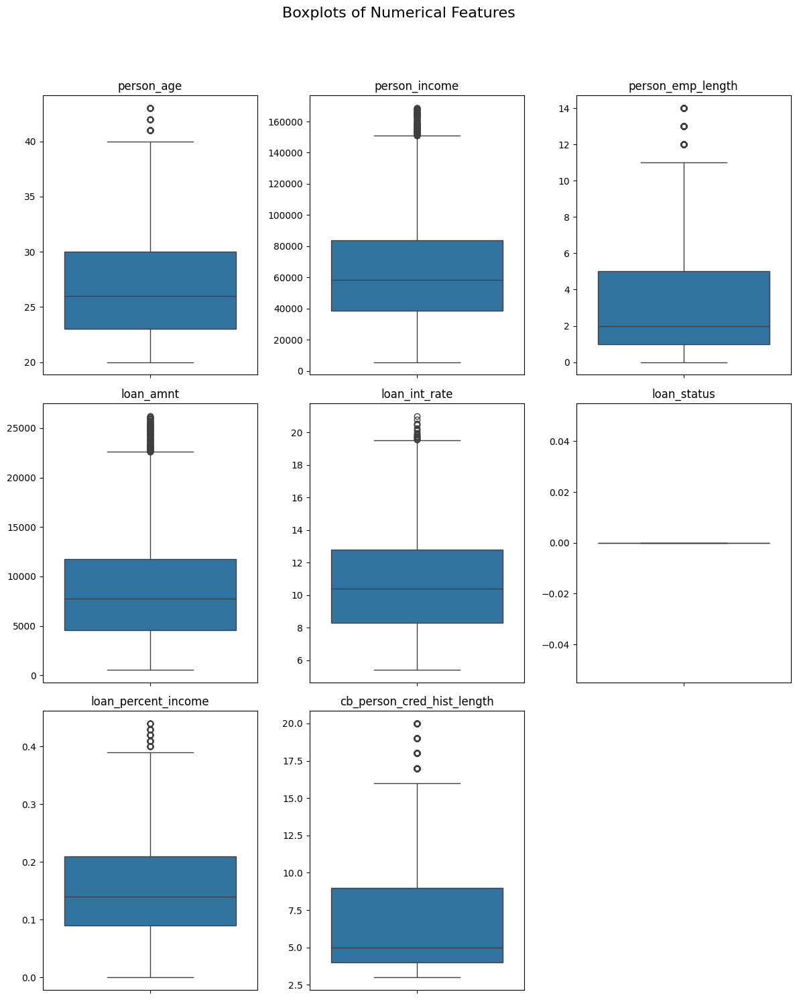

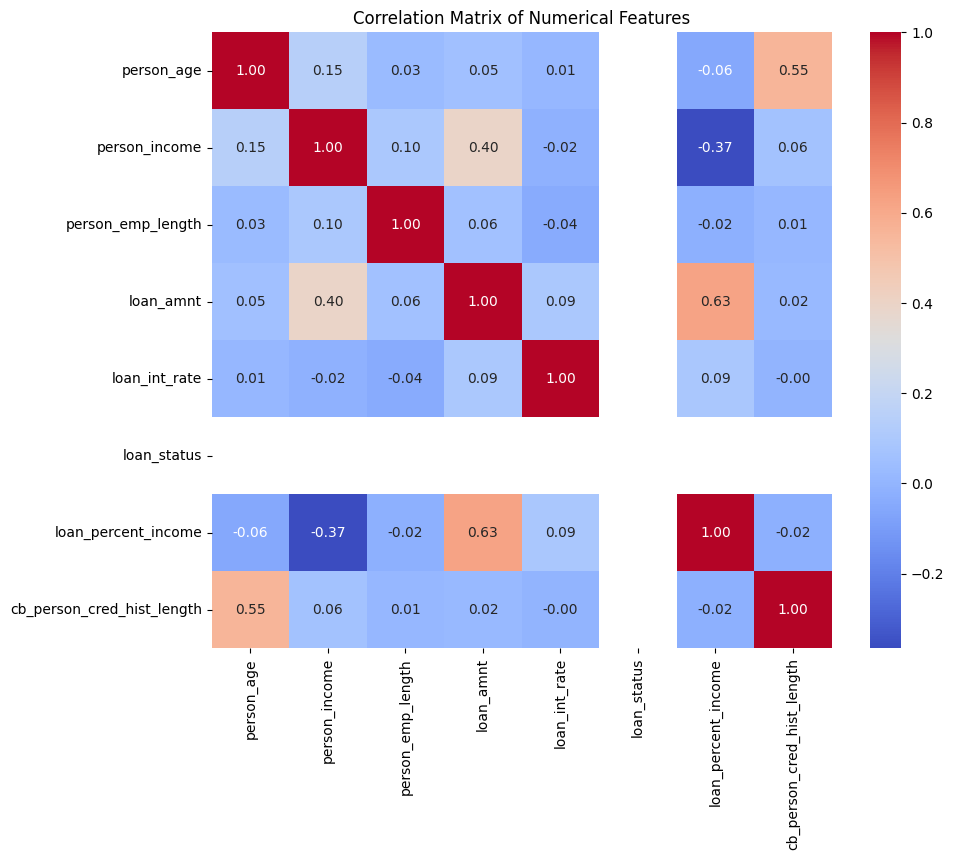


Generating Pairplot on all numerical features (this might take some time)...


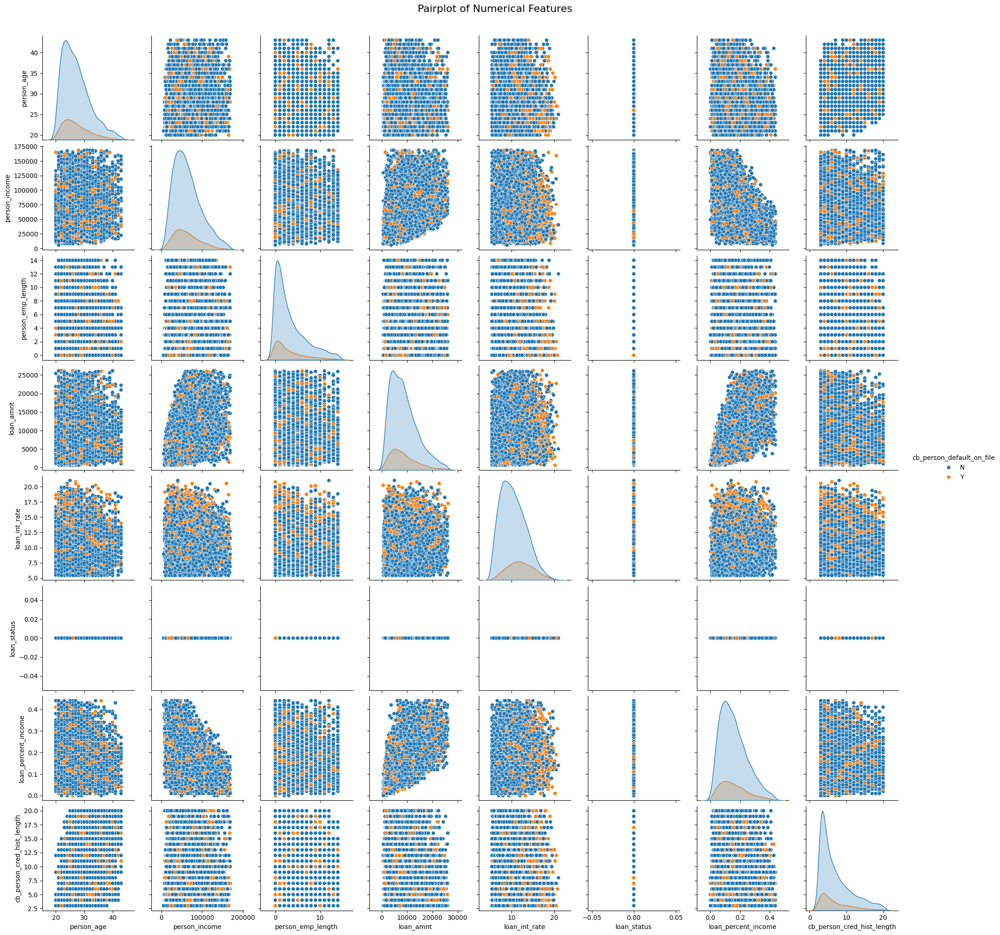

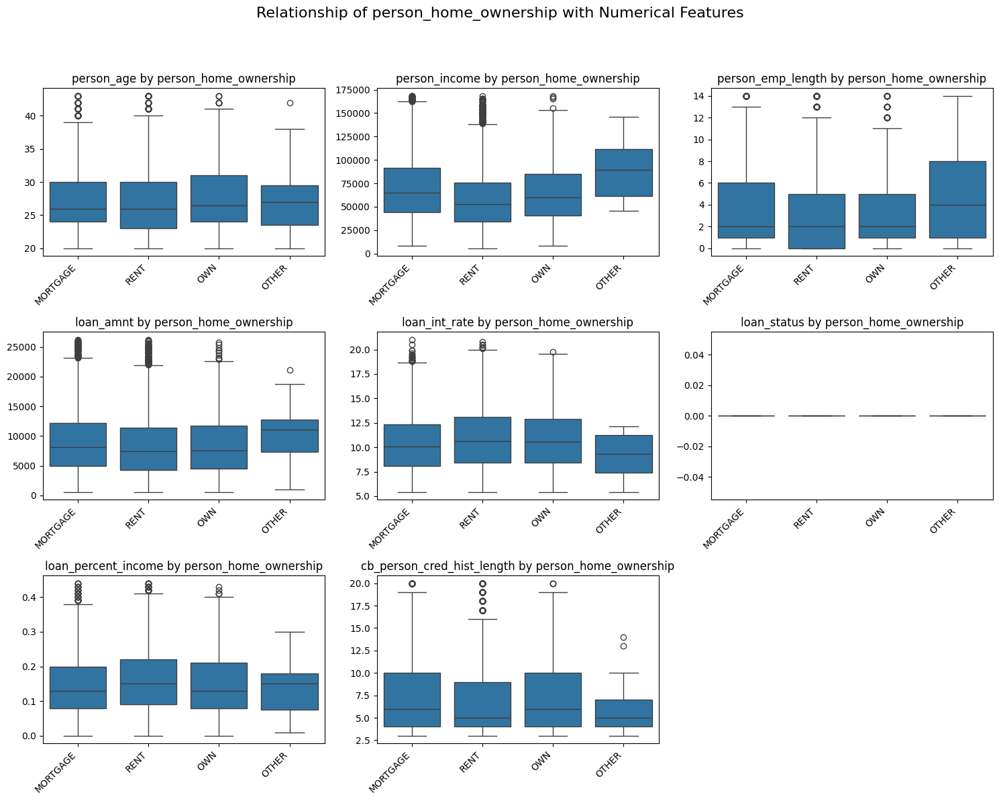

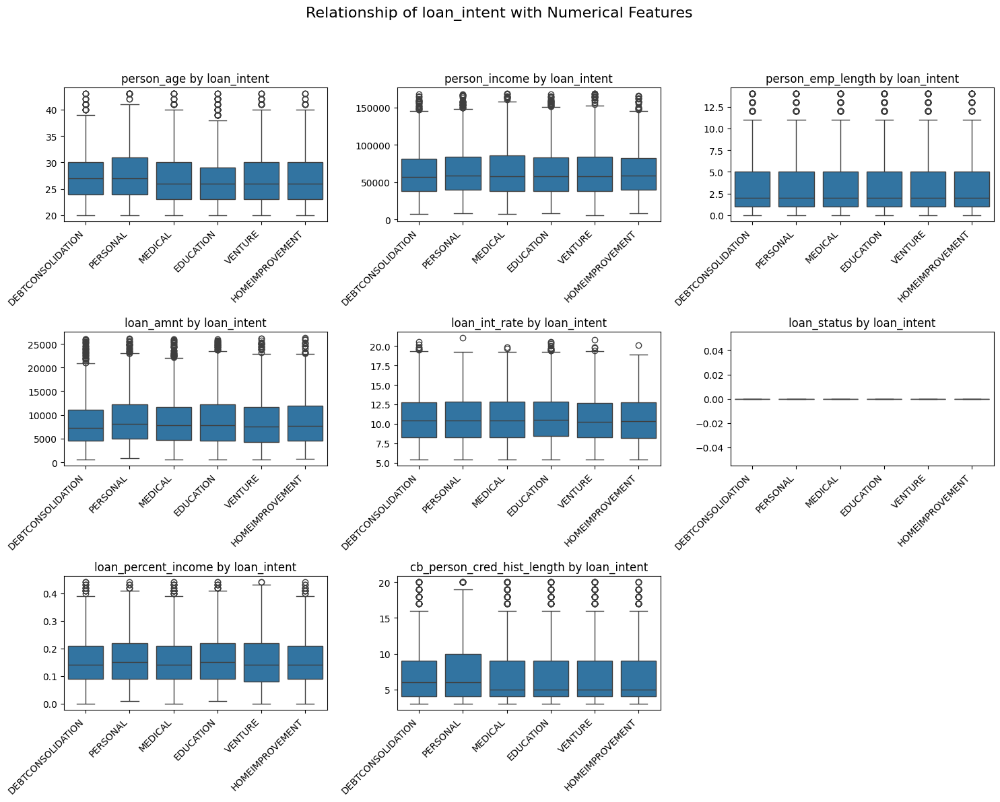

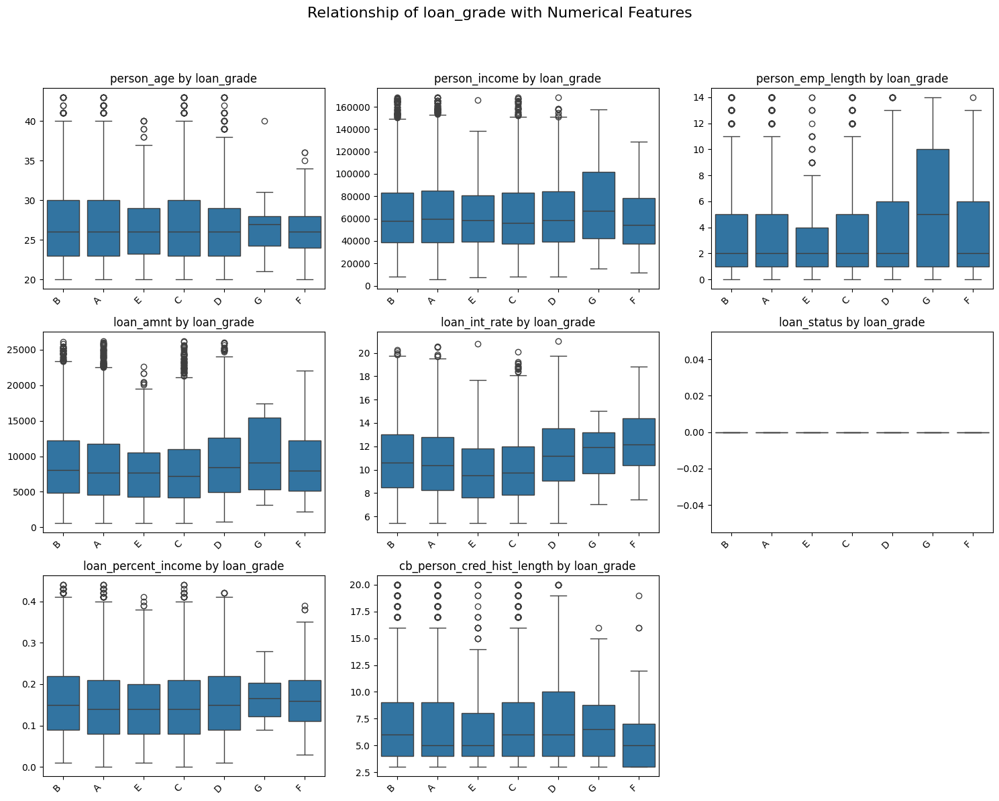

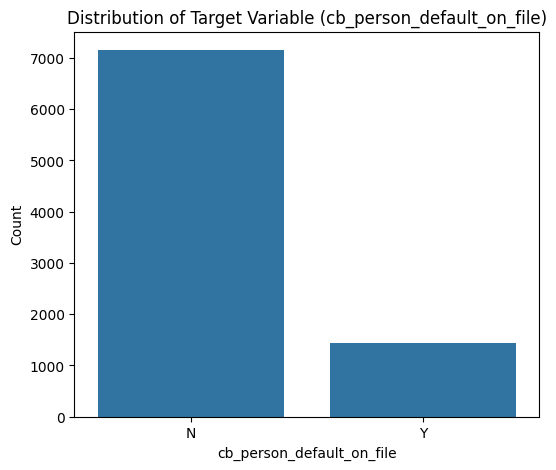

In [ ]:
# Vérifions que la répartition de données est encore présente
# On ne fera ici qu'avec GCS pour de simplicité d'affichage mais les résultats restent assez similaires, de plus c'est celui qui a eu le meilleur résultat avec 83.54%

plot_numerical_eda(remove_outliers_iqr(synthetic_data_GCS), ncols=3)

On retrouve le lien entre l'âge d'une personne et son historique de crédit. Haut revenu/Emprunt important et moins grande partie du revenu. Ou alors que plus un emprunt est élevé et plus il fait partie importante dans du revenu d'une personne. Enfin, même si peut-être de manière un peu moins net que pour les données originelles on voit que plus le taux d'intérêt est élévé et plus les risques de défaut s'accentuent

# **Partie 3 : Entrainement des modèles sur les différents jeux de données**

On a pu voir dans la partie précédente que les données crées par nos modèles semble bien suivre les originaux mais au-dela d'une simple visualisation, l'idée serait de voir si dans une prédiction, ces modèles peuvent donnéer des data qui se confondent avec la réalité ou non

L'idée serait d'utiliser ces données sur un modèle très classique du style RandomForestClassifier en ciblant le défaut de paiement.

Pour évaluer la pertinence d'un modèle mais surtout des données en entrée au vu du fait que tout utiliseront le même modèle, il faut voir nos métriques.

Dans un contexte d'attribution crédit et de classification, alors deux métriques se pose assez rapidement :

D'abord le recall, en effet, celui-ci serait ici, la capacité à détecter les défauts de paiements, dans un cas classique de délivrance de crédit, on cherche à limiter le plus possible l'accès à celui-ci aux personne qui vont faire défaut.

En suite la précision, sortir les futures personnes en défaut, et limiter donc le risque, il est nécessaire cependant d'attribuer des crédits pour faire fonctionner l'entreprise. Augmenter la précision permettrait ainsi de limiter le nombre de personne que l'on définirait comme à risque alors qu'elle ne le sont pas.

 Le recall serait donc ici le risque en tant que tel, il faut le limiter le plus possible car on ne souhaite pas générer de la valeur sur les personnes qui ne paye pas. Elle serait la métrique "principale" dans un classique

La précision, elle, serait plus lié à la rentabilité. Un client refusé parce qu'il est considéré comme à risque à tort est un revenu en moins pour l'organisme. Elle est la métrique "secondaire" et son augmentation permettrait d'augmenter la rentabilité

In [ ]:
# Création de données et de la variable cible avec encodage des données catégoriels de base

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

# Train
X_train = df.drop('cb_person_default_on_file', axis=1)
y_train = df['cb_person_default_on_file']

X_train = pd.get_dummies(X_train, columns=X_train.select_dtypes(include=['object']).columns)

# Test
X_test = df_test.drop('cb_person_default_on_file', axis=1)
y_test = df_test['cb_person_default_on_file']

X_test = pd.get_dummies(X_test, columns=X_test.select_dtypes(include=['object']).columns)

In [ ]:
# Fonction d'entrainement et d'évaluation des RFC

def train_and_evaluate_random_forest(synthetic_data, X_test_global, y_test_global):

    # Preprocessing données synthetiques
    X_synth = synthetic_data.drop('cb_person_default_on_file', axis=1)
    X_synth = pd.get_dummies(X_synth, columns=X_synth.select_dtypes(include=['object']).columns)
    y_synth = synthetic_data['cb_person_default_on_file']

    # Entrainement sur les données synthetiques pures
    rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
    rf_classifier.fit(X_synth, y_synth)

    # Evaluer par rapport aux données de bases
    X_test = X_test_global[X_synth.columns]
    y_pred = rf_classifier.predict(X_test)
    accuracy = accuracy_score(y_test_global, y_pred)
    print(f"Accuracy on original test data using synthetic data: {accuracy}")
    print(classification_report(y_test_global, y_pred))
    return accuracy

In [ ]:
# Evaluation sur les données originelles
train_and_evaluate_random_forest(df, X_test, y_test)

Accuracy on original test data using synthetic data: 0.8313641245972073
              precision    recall  f1-score   support

           N       0.89      0.90      0.90      5322
           Y       0.54      0.53      0.53      1195

    accuracy                           0.83      6517
   macro avg       0.72      0.71      0.72      6517
weighted avg       0.83      0.83      0.83      6517



0.8313641245972073

Voici donc ce qui nous servira de base comme valeurs, on suppose qu'on cherche à définir si une personne va faire défaut ou pas.

Ainsi, les données de base permettent de trouver 53% des défauts de paiements.

Aussi, dans 54% dans personne considérer comme à risque, ne le sont pas réellement

On est donc sur un très bon ratio pour les personnes ne faisant pas défaut (≃0.9) mais pour ce qui est des personnes à risques, on se place sur très bonne représentation du hasard (0.53), il faut voir si nos données synthétiques peuvent améliorer ça, une chance sur deux de laisser passer un défaut n'est pas tolérable dans notre contexte

In [ ]:
# Lancement des différentes évaluations
train_and_evaluate_random_forest(synthetic_data_GAN, X_test, y_test)
train_and_evaluate_random_forest(synthetic_data_GCS, X_test, y_test)
train_and_evaluate_random_forest(synthetic_data_TVAES, X_test, y_test)
train_and_evaluate_random_forest(synthetic_data_EXP, X_test, y_test)

Accuracy on original test data using synthetic data: 0.8215436550560073
              precision    recall  f1-score   support

           N       0.86      0.93      0.89      5322
           Y       0.52      0.34      0.41      1195

    accuracy                           0.82      6517
   macro avg       0.69      0.64      0.65      6517
weighted avg       0.80      0.82      0.81      6517

Accuracy on original test data using synthetic data: 0.8163265306122449
              precision    recall  f1-score   support

           N       0.82      1.00      0.90      5322
           Y       0.45      0.01      0.01      1195

    accuracy                           0.82      6517
   macro avg       0.63      0.50      0.46      6517
weighted avg       0.75      0.82      0.74      6517

Accuracy on original test data using synthetic data: 0.8229246585852386
              precision    recall  f1-score   support

           N       0.88      0.90      0.89      5322
           Y       0.

0.8190885376707073

Rappellons ainsi les nombres données pour les données de bases ainsi que nos résultats :



*   Originelle *: R = 0.53 / P = 0.54*
*   GAN *: R = 0.34 / P = 0.52*
*   GCS *: R = 0.01 / P = 0.45*
*   TVAES *: R = 0.47 / P = 0.52*
*   EXP *: R = 0.38 / P = 0.51*


On voit que pour le TVAES, nos données restent dans l'ordre de nos données originelles. Ce qui montre bien l'efficacité et la cohérence de nos données générées. On peut ainsi voir que l'on peut fournir à un modèle bien plus de données si besoin est. Aussi, bien qu'ayant la meilleur évaluation de qualité GCS est celui qui a le moins bien performé dans la génération pure

Il est à noté que l'on utilise les paramètres de base pour simplifier la comparaison, il est possible qu'en modifiant les paramètres tel que la distribution peut eventuellement améliorer les résultats

Cependant, même si elle reproduit bien les performances, l'idée serait surtout de les améliorer. On passe donc un système où on rééquilibre la variable cible pour voir si on peut améliorer le recall et la précision sur les défauts en leurs donnant plus de données

# **Partie 3.5 : Entrainement des modèles sur les différents jeux de données rééquilibré**

In [ ]:
# Maintenant on cherche à rééqulibrer la variable cible afin de potentiellement améliorer l'efficacité des modèles

def resample_with_conditional_generation(original_df, synthesizer, target_column='cb_person_default_on_file'):

    # Partie sur la gestion du déséquilibre
    class_counts = original_df[target_column].value_counts()

    majority_class = class_counts.idxmax()
    minority_class = class_counts.idxmin()
    majority_count = class_counts.max()
    minority_count = class_counts.min()

    print(f"Original distribution: {majority_class}: {majority_count}, {minority_class}: {minority_count}")

    samples_to_generate = majority_count - minority_count

    if samples_to_generate <= 0:
        print("Classes are already balanced or minority class is larger. No generation needed.")
        return original_df.copy()

    print(f"Generating {samples_to_generate} samples for minority class '{minority_class}'")

    # Création de la condition avec le bon nombre de ligne
    minority_condition = Condition(
        num_rows=samples_to_generate,
        column_values={target_column: minority_class}
    )

    # Synthetisation
    synthetic_minority_data = synthesizer.sample_from_conditions(
        conditions=[minority_condition],
        max_tries_per_batch=1000
    )

    # Ajout de ces données dans le dataset original pour permettre un bon rééquilibrage
    balanced_df = pd.concat([original_df, synthetic_minority_data], ignore_index=True)

    print(f"New distribution: {balanced_df[target_column].value_counts()}")

    return balanced_df




In [ ]:
# Balance using CTGAN
df_balanced_GAN = resample_with_conditional_generation(df, synthesizer_GAN)

# Balance using Gaussian Copula
df_balanced_GCS = resample_with_conditional_generation(df, synthesizer_GCS)

# Balance using TVAES
df_balanced_TVAES = resample_with_conditional_generation(df, synthesizer_TVAES)

# Balance using CopulaGAN (Experimental)
df_balanced_EXP = resample_with_conditional_generation(df, synthesizer_EXP)


Original distribution: N: 21514, Y: 4550
Generating 16964 samples for minority class 'Y'


Sampling conditions: 100%|██████████| 16964/16964 [00:02<00:00, 8476.18it/s]


New distribution: cb_person_default_on_file
Y    21514
N    21514
Name: count, dtype: int64
Original distribution: N: 21514, Y: 4550
Generating 16964 samples for minority class 'Y'


Sampling conditions: 100%|██████████| 16964/16964 [00:01<00:00, 12121.38it/s]


New distribution: cb_person_default_on_file
Y    21514
N    21514
Name: count, dtype: int64
Original distribution: N: 21514, Y: 4550
Generating 16964 samples for minority class 'Y'


Sampling conditions: 100%|██████████| 16964/16964 [00:01<00:00, 8546.74it/s]


New distribution: cb_person_default_on_file
Y    21514
N    21514
Name: count, dtype: int64
Original distribution: N: 21514, Y: 4550
Generating 16964 samples for minority class 'Y'


Sampling conditions: 100%|██████████| 16964/16964 [00:03<00:00, 4649.00it/s]

New distribution: cb_person_default_on_file
Y    21514
N    21514
Name: count, dtype: int64


In [ ]:
# Utilisation du mix données réelles/synthétiques rééquilibré afin de voir si la performance sur un random forest s'en trouve améliorer

print("\n--- Evaluating Random Forest on GAN Balanced Data ---")
# Pass the balanced training data and the original test data to the function
train_and_evaluate_random_forest(df_balanced_GAN, X_test, y_test)

print("\n--- Evaluating Random Forest on GCS Balanced Data ---")
train_and_evaluate_random_forest(df_balanced_GCS, X_test, y_test)

print("\n--- Evaluating Random Forest on TVAES Balanced Data ---")
train_and_evaluate_random_forest(df_balanced_TVAES, X_test, y_test)

# For CopulaGAN balanced data (Experimental)
print("\n--- Evaluating Random Forest on CopulaGAN Balanced Data ---")
train_and_evaluate_random_forest(df_balanced_EXP, X_test, y_test)


--- Evaluating Random Forest on GAN Balanced Data ---
Accuracy on original test data using synthetic data: 0.8266073346631886
              precision    recall  f1-score   support

           N       0.93      0.85      0.89      5322
           Y       0.52      0.74      0.61      1195

    accuracy                           0.83      6517
   macro avg       0.73      0.79      0.75      6517
weighted avg       0.86      0.83      0.84      6517


--- Evaluating Random Forest on GCS Balanced Data ---
Accuracy on original test data using synthetic data: 0.8141783029001074
              precision    recall  f1-score   support

           N       0.93      0.83      0.88      5322
           Y       0.50      0.73      0.59      1195

    accuracy                           0.81      6517
   macro avg       0.71      0.78      0.73      6517
weighted avg       0.85      0.81      0.83      6517


--- Evaluating Random Forest on TVAES Balanced Data ---
Accuracy on original test data usin

0.8267607794997698

Données purement synthétiques :




*   Originelle *: R = 0.53 / P = 0.54*
*   GAN *: R = 0.34 / P = 0.52*
*   GCS *: R = 0.01 / P = 0.45*
*   TVAES *: R = 0.47 / P = 0.52*
*   EXP *: R = 0.38 / P = 0.51*


Données réelles rééquilibrés :




*   GAN *: R = 0.74 / P = 0.52*
*   GCS *: R = 0.73 / P = 0.50*
*   TVAES *: R = 0.65 / P = 0.52*
*   EXP *: R = 0.75 / P = 0.52*


De manière générale la rentabilité (précision) n'est pas affecté par notre ajout de données, cependant on a une nette amélioration du risque (recall), ici on passe de 53% de personne en défauts à minimum 65% soit une amélioration de 12 points (encore 9 point de plus dans le meilleurs cas)

Il y a donc un réel intérêt à genérer des données pour améliorer notre efficacité

# **Partie 4 : Entrainement des modèles sur des données basés sur un LLM**

Notre première idée de projet était de trouver une utilité aux GAN, et pourquopas de générer des faux articles financiers et ainsi de permettre leurs détections aux mieux. Cependant, il nosu est paru assez évident qu'un modèle LLM aurait toujours de bien meilleurs résultats en rédaction d'articles. C'est alors qu el'on s'est posé la question inverse, est-ce que les LLMs aurait de bon résultats sur la génération de données tabulaires comportant des liens entre eux

Les LLMs se devenant de plus en plus puissant et multi-modale, une idée aurait été de les utiliser afin de voir leurs efficacités, ici c'est chatGPT qui nous a donné ces résultats. Il est à noter qu'avec les possibilités de faire tourner du code en ligne directement depuis le chat, chatGPT proposé d'utiliser SDV. Après l'avoir demandé de créer des do nnées cohérentes lui-même, voici les résultats

In [ ]:
import pandas as pd
url = 'https://gist.github.com/The-Girulas/b0b267d9d08459d67f1f02532712c9ea/raw/d7930f828a2b61c0e2e86b4b2b4dedcccee92927/synthetic_output.csv'
synthetic_data_LLM = pd.read_csv(url, delimiter=';')

for col in synthetic_data_LLM.columns:
    if synthetic_data_LLM[col].dtype == 'object':
        try:
            synthetic_data_LLM[col] = pd.to_numeric(synthetic_data_LLM[col].replace({',': '.'}, regex=True), errors='raise')
        except ValueError:
            pass

print("Synthetic data LLM :")
print(synthetic_data_LLM.head())

Synthetic data LLM :
   person_age  person_income person_home_ownership  person_emp_length  \
0          48          89611                 OTHER                  7   
1          37          47487                 OTHER                  8   
2          54          99870                   OWN                  6   
3          57          18507                 OTHER                 10   
4          60          87108                   OWN                  8   

         loan_intent loan_grade  loan_amnt  loan_int_rate  loan_status  \
0  DEBTCONSOLIDATION          B      23800           9.69            0   
1    HOMEIMPROVEMENT          D       6300          16.34            1   
2           PERSONAL          F      24300          21.76            0   
3            MEDICAL          A       5700           7.80            0   
4            VENTURE          B      30400          10.83            0   

   loan_percent_income cb_person_default_on_file  cb_person_cred_hist_length  
0               

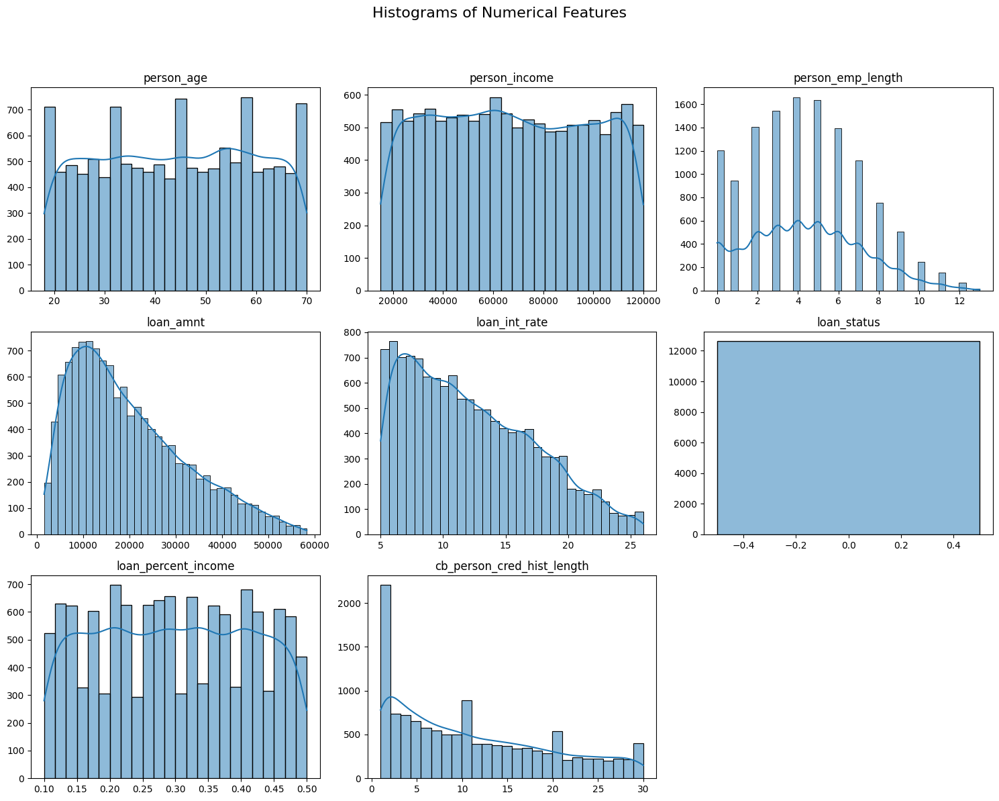

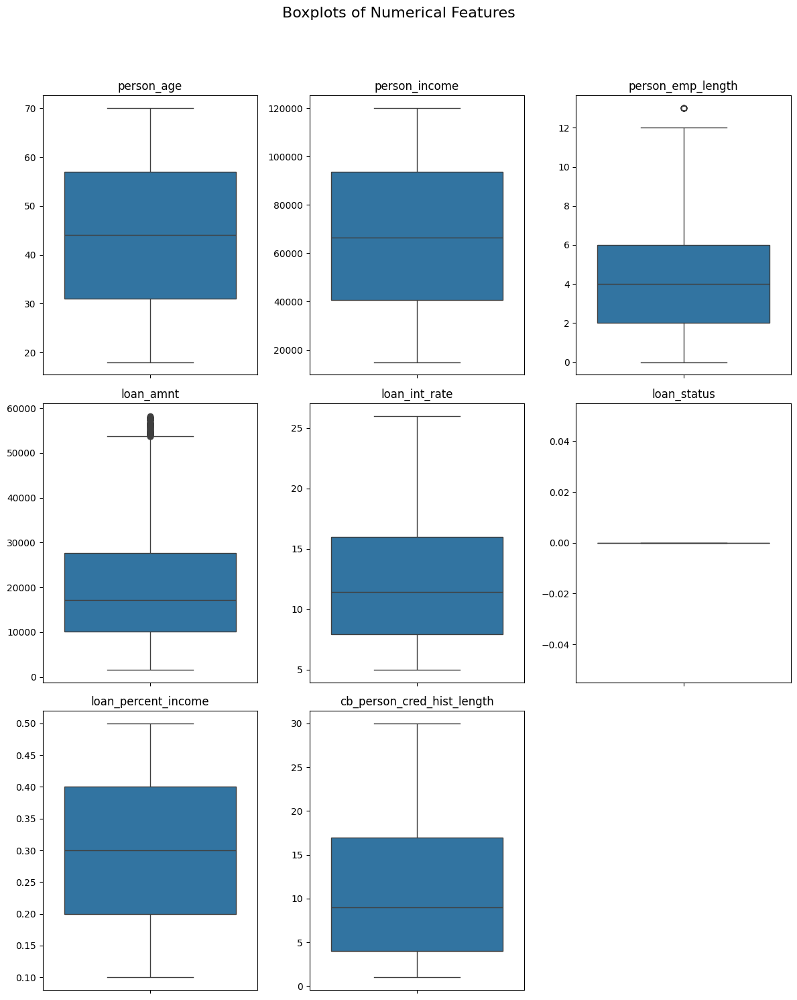

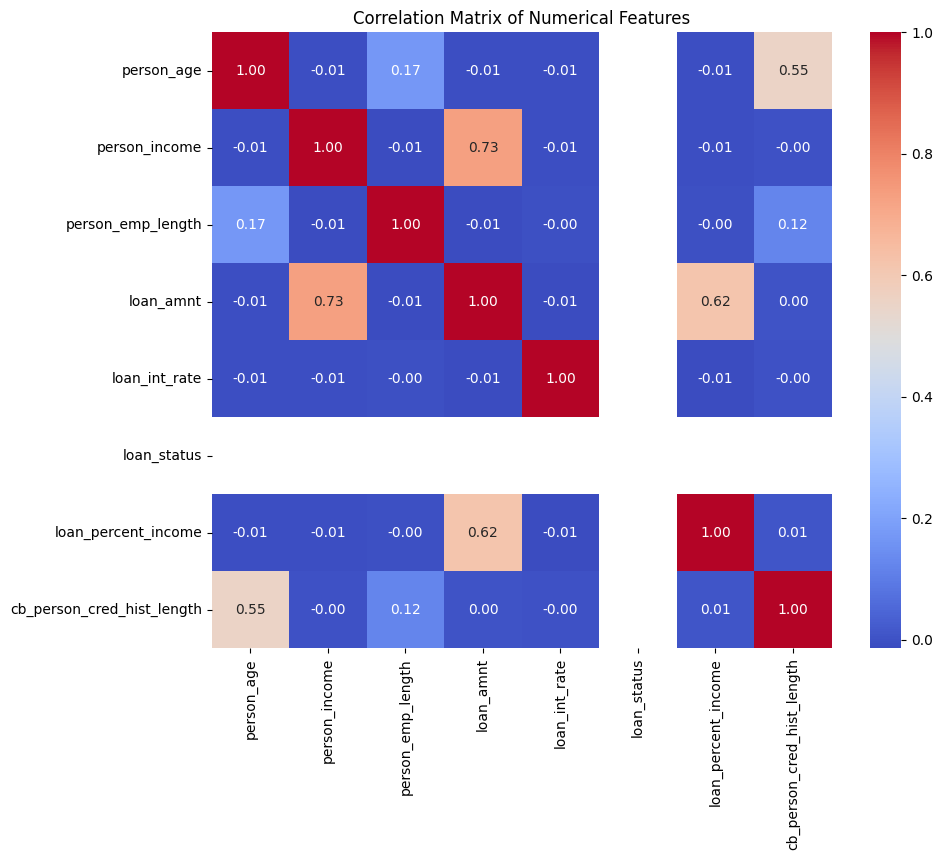


Generating Pairplot on all numerical features (this might take some time)...


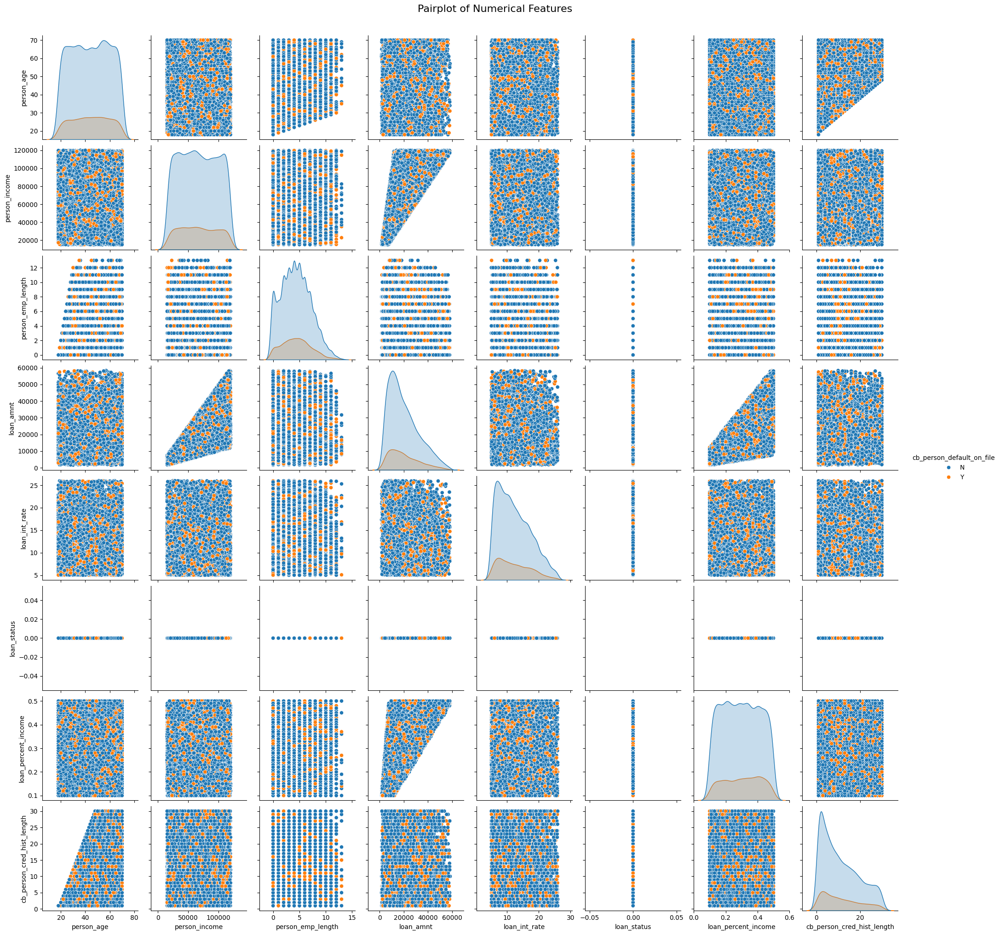

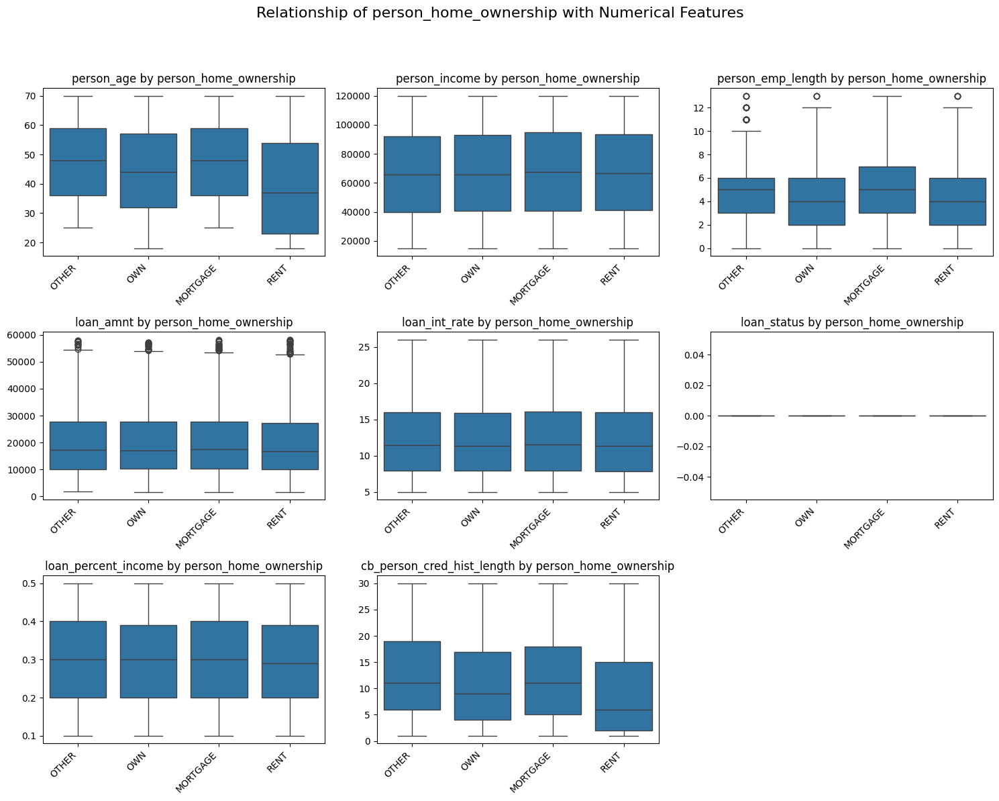

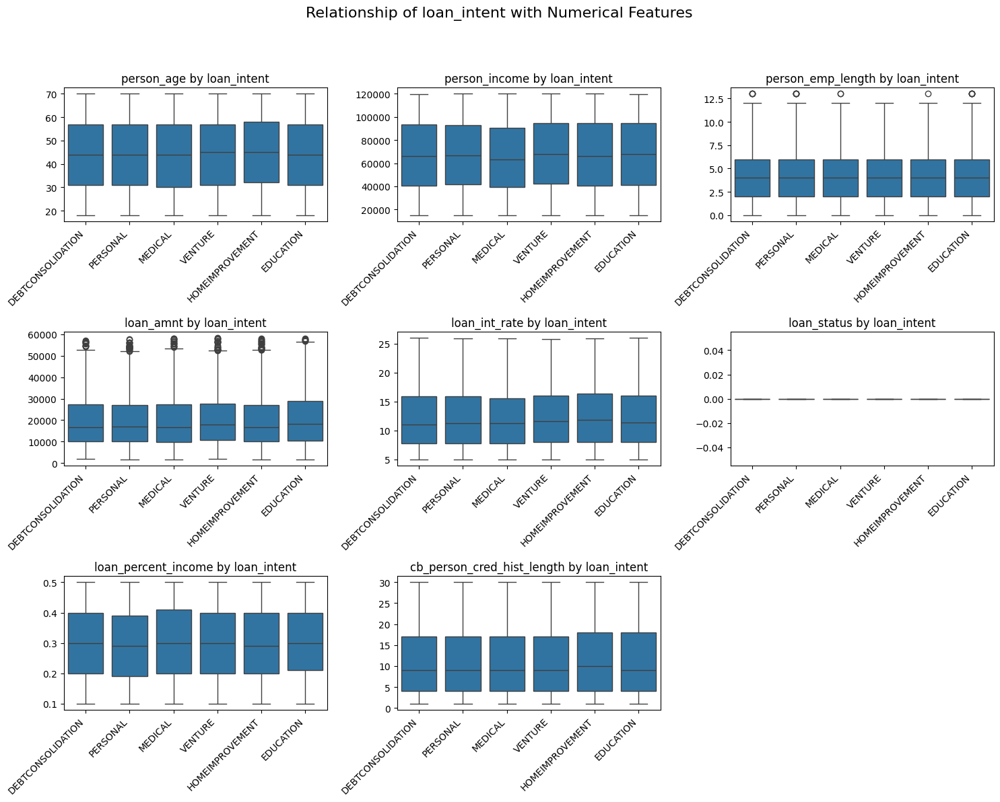

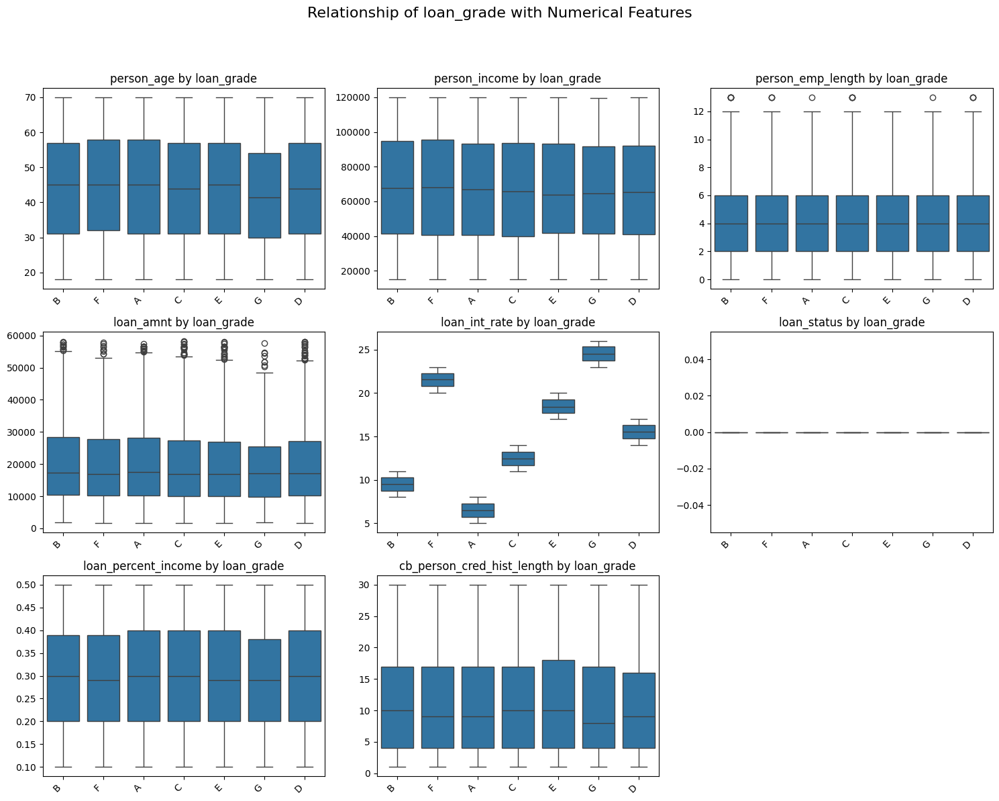

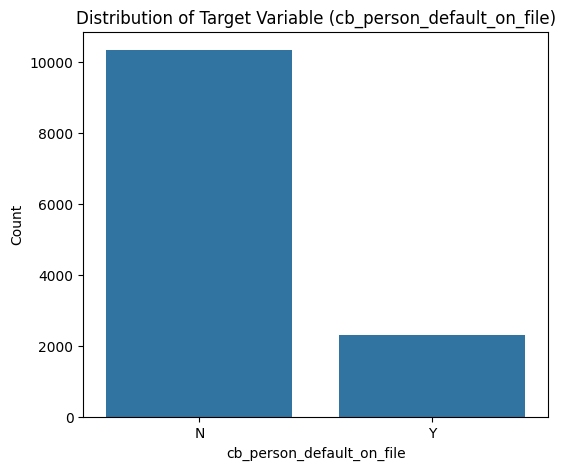

In [ ]:
# Visualition de données par LLM

plot_numerical_eda(remove_outliers_iqr(synthetic_data_LLM), ncols=3)

On remarque que le LLM réussi à reproduire une certaine cohérence dans les données comme on l'a vu précedemment, cependant il manque le point sur le fait que les haut revenus ont une moins grande part de celui-ci dans le prêt. Le LLM n'a pas réussi à reproduire cette subtilité. Aussi, on perd la notion qui est que plus grand est le taux d'intérêt plus les clients ont tendances à faire défaut. Cette notion importante se répercutera pour sûr dans nos résultats

In [ ]:
# Evalution des données purement synthétiques via LLM

train_and_evaluate_random_forest(synthetic_data_LLM, X_test, y_test)

Accuracy on original test data using synthetic data: 0.8115697406782262
              precision    recall  f1-score   support

           N       0.82      0.99      0.90      5322
           Y       0.21      0.01      0.02      1195

    accuracy                           0.81      6517
   macro avg       0.51      0.50      0.46      6517
weighted avg       0.71      0.81      0.74      6517



0.8115697406782262

Données purement synthétiques :




*   Originelle *: R = 0.53 / P = 0.54*
*   GAN *: R = 0.34 / P = 0.52*
*   GCS *: R = 0.01 / P = 0.45*
*   TVAES *: R = 0.47 / P = 0.52*
*   EXP *: R = 0.38 / P = 0.51*
*   LLM *: R = 0.01 / P = 0.21*



On voit assez aisément que le LLM est très mauvais pour créer des données purement synthétique en se basant sur des données réelles. N'importe lequel de nos modèles à de l'avance sur le LLM. On a vu que certaines subtilités manquaient dont notamment celle du taux d'intérêt qui est un point central dans la gestion de risque dans les crédits.

In [ ]:
url = 'https://gist.github.com/The-Girulas/c3f447c756240126fa0e1a9edb34956c/raw/c1c7ae1e72a51097f77aceb4f525c84ec216e3a1/balanced.csv'
synthetic_data_LLM_balanced = pd.read_csv(url)

for col in synthetic_data_LLM_balanced.columns:
    if synthetic_data_LLM_balanced[col].dtype == 'object':
        try:
            # Attempt to convert to numeric after replacing comma with period
            synthetic_data_LLM_balanced[col] = pd.to_numeric(synthetic_data_LLM_balanced[col].replace({',': '.'}, regex=True), errors='raise')
        except ValueError:
            # If conversion fails, keep as object (likely a true categorical column)
            pass

print("Synthetic data LLM balanced :")
print(synthetic_data_LLM_balanced.head())

train_and_evaluate_random_forest(synthetic_data_LLM_balanced, X_test, y_test)

Synthetic data LLM balanced :
   person_age  person_income person_home_ownership  person_emp_length  \
0          64          46000                  RENT                2.0   
1          26          26000                   OWN                0.0   
2          23          51000              MORTGAGE                3.0   
3          22          56004              MORTGAGE                6.0   
4          24          79000                  RENT                3.0   

         loan_intent loan_grade  loan_amnt  loan_int_rate  loan_status  \
0           PERSONAL          C       4800          11.09            0   
1  DEBTCONSOLIDATION          E       8500          16.45            1   
2           PERSONAL          C      16000          13.11            0   
3            MEDICAL          A       6000           7.88            0   
4           PERSONAL          C       7000          12.54            0   

   loan_percent_income cb_person_default_on_file  cb_person_cred_hist_length  
0      

0.8267607794997698

Données réelles rééquilibrés :




*   GAN *: R = 0.74 / P = 0.52*
*   GCS *: R = 0.73 / P = 0.50*
*   TVAES *: R = 0.65 / P = 0.52*
*   EXP *: R = 0.75 / P = 0.52*
*   LLM *: R = 0.59 / P = 0.52*



Bien que de la même manière qu'avec le GCS, le LLM à de bien meilleurs résultats dans un cas rééquilibrage. Cependant, il reste toujours plus bas que nos modèles de SDV

En soit, à première vue, la synthétistion de données via LLM semblent être une solution possible dans les cas de rééquilibrage mais n'est pas la meilleure solution selon nos métriques. Cependant, il est possible que d'autres modèles de prédictions puissent trouver de meilleurs résultats.

# **Partie 5 : Conclusion**

L'exploration des possibilités de synthétisation des données via SDV ou LLM a été un travail très intéréssant. En plus d'être dans l'air du temps avec des super modèles comme les LLM qui ont été entrainé sur la plus part des données disponibles ou bien plus simplement sur des données déséquilibrés comme dans notre projet.

La synthétisation de données pures pour certain modèle peut se confondre avec les données originelles, on pense au TVAES et EXP qui, selon l'objectif, peut être une bonne solution.

Cependant, nos meilleurs résultats se trouvent avec la génération conditionelle, en rééquilibrant la variable cible on a pu voir une nette amélioration du recall et donc dans notre contexte une meilleure gestion du risque. Ces générations conditionelles peuvent être poussé pour visé une certaine catégorie de client et pourrait même adapter aux clients en visant des objectifs encore plus poussés.

Enfin, si note choix dans un contexte professionel devait se poser, celui-ci irait à priori sur le GAN qui fournit la meilleur gestion de la performance ajustée au risque. Il est à noté que l'on a utilisé des modèles très simples. Des modèles plus complexe existe dans la version professionelle de SDV. Aussi les modèle de base ont été utilisé "vanilla", et notre modèle de prédiction est un RTC. Si un tel projet était améné dans un contexte professionel, il faudrait explorer d'autres possibilités. A ces possibilités se rajoutent donc celle de créer des données pour améliorer la performance des modèles.

***Bibliographie*** :



*   https://docs.sdv.dev/sdv
*   https://chatgpt.com/ (génération de données)
*   https://www.kaggle.com/datasets/laotse/credit-risk-dataset
*   https://inside-machinelearning.com/recall-precision-f1-score/
*   https://gemini.google.com/app

